<a href="https://colab.research.google.com/github/Daalma7/ProyectoVC/blob/master/proyectoVC.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# -*- coding: utf-8 -*-

from google.colab import drive
drive.mount('/content/drive')


Mounted at /content/drive


Para empezar, vamos a importar las librerías necesarias y a especificar parámetros necesarios. Habilitamos uso de GPU, y ponemos una semilla aleatoria para intentar controlar la reproducibilidada de los experimentos

Vamos a importar funciones auxiliares que hemos utilizado en otras prácticas anteriores que nos servirán para calcular mostrar resultados. Además vamos a definir una función  que servirá para especificar cómo se deben leer las imágenes que utilizaremos en nuestro estudio

In [ ]:
# Importar librerías necesarias
import tensorflow as tf
import numpy as np
import keras
import keras.utils as np_utils
from keras.preprocessing.image import load_img,img_to_array
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from matplotlib import pyplot
from keras.applications import DenseNet121
from keras.applications.resnet import ResNet50
from keras.applications import VGG19,InceptionV3,Xception
from sklearn.metrics import confusion_matrix


#OJO aquí habilito uso de GPU. Desactivar luego

device_name = tf.test.gpu_device_name()
if device_name != '/device:GPU:0':
  print(
      '\n\nThis error most likely means that this notebook is not '
      'configured to use a GPU.  Change this in Notebook Settings via the '
      'command palette (cmd/ctrl-shift-P) or the Edit menu.\n\n')
  raise SystemError('GPU device not found')

tf.device('/device:GPU:0')


# Importar el optimizador a usar
from keras.optimizers import SGD

# Importar modelos y capas específicas que se van a usar
from keras.preprocessing.image import ImageDataGenerator

#Path donde se encontrarán las imágenes del proyecto
path = '/content/drive/MyDrive/GoogleColab/proyectoImagenes'

#Semilla aleatoria para controlar las ejecuciones del programa y garantizar reproducibilidad
np.random.seed(50)

In [ ]:
"""------------------------FUNCIONES AUXILIARES DE PRÁCTICAS ANTERIORES----------------------------"""

def pintaI(image, flag_color=1, image_title = "Imagen", window_title = "Ejercicio"):
    #image=cv.normalize(image, None, 0.0, 1.0, cv.NORM_MINMAX)
    image = image.astype(np.uint8)
    plt.figure(0).canvas.set_window_title(window_title) # Ponemos nombre a la ventana
    if flag_color == 0:
        plt.imshow(image, cmap = "gray")
    else:
        plt.imshow(image)
    plt.title(image_title)              # Ponemos nombre a la imagen
    plt.show()
    image = image.astype(np.float64)    # Devolvemos su formato

def calcularAccuracy(labels, preds):
    labels = np.argmax(labels, axis = 1)
    preds = np.argmax(preds, axis = 1)
    accuracy = sum(labels == preds)/len(labels)
    return accuracy

def mostrarEvolucion(hist):
    loss = hist.history['loss']
    val_loss = hist.history['val_loss']
    plt.plot(loss)
    plt.plot(val_loss)
    plt.legend(['Training loss', 'Validation loss'])
    plt.show()

    
    acc = hist.history['acc']
    val_acc = hist.history['val_acc']
    plt.plot(acc)
    plt.plot(val_acc)
    plt.legend(['Training accuracy','Validation accuracy'])
    plt.ylim(0,1)           #Meto esto para mejor comparación de gráficas
    plt.show()

"""------------------------------------LECTURA DE IMÁGENES ----------------------------------------"""

def leerImagenes(clases, num_imgs, path):
  
  imgs_covid = np.array([img_to_array(load_img(path + "/" + clases[i] + "/" + clases[i] + " (" + str(i+1) + ").png",
                                                target_size = (224, 224), interpolation="bilinear")) for i in range(0,num_imgs)])
  imgs_normal = np.array([img_to_array(load_img(path + "/" + clases[i] + "/" + clases[i] + " (" + str(i-num_imgs+1) + ").png",
                                                target_size = (224, 224), interpolation="bilinear")) for i in range(num_imgs,2*num_imgs)])
  imgs_viral = np.array([img_to_array(load_img(path + "/" + clases[i] + "/" + clases[i] + " (" + str(i-2*num_imgs+1) + ").png", 
                                                target_size = (224, 224), interpolation="bilinear")) for i in range(2*num_imgs,3*num_imgs)])

  return imgs_covid, imgs_normal, imgs_viral


#Genero primero las etiquetas sabiendo que hay 1200 imágenes positivas de COVID, 1341 imágenes normales
#y 1345 imágenes de neumonía vírica

#Elegimos el número de imágenes por clase que vamos a utilizar
num_imgs=1200
clases=[]
for i in range(1,3*num_imgs+1):
  if (i<=num_imgs):
    clases.append('COVID')
  elif (i<=2*num_imgs):
    clases.append('NORMAL')
  else:
    clases.append('Viral Pneumonia')




imgs_covid, imgs_normal, imgs_viral = leerImagenes(clases,num_imgs, path)
#imagenes = np.array([img_to_array(load_img(path + "/COVID/" + "COVID (1).png"))])

print("Se han leido ", len(imgs_covid) + len(imgs_normal) + len(imgs_viral), " imagenes.")

Se han leido  3600  imagenes.


Vamos a generar primero las etiquetas sabiendo que hay 1200 imágenes positivas de COVID, 1341 imágenes normales y 1345 imágenes de neumonía vírica. Especificamos el número de imágenes de cada clase que vamos a usar en nuestro estudio con el parámetro num_imgs

In [ ]:
#Genero primero las etiquetas sabiendo que hay 1200 imágenes positivas de COVID, 1341 imágenes normales
#y 1345 imágenes de neumonía vírica

#Elegimos el número de imágenes por clase que vamos a utilizar
num_imgs=1200
clases=[]
for i in range(1,3*num_imgs+1):
  if (i<=num_imgs):
    clases.append('COVID')
  elif (i<=2*num_imgs):
    clases.append('NORMAL')
  else:
    clases.append('Viral Pneumonia')




imgs_covid, imgs_normal, imgs_viral = leerImagenes(clases,num_imgs, path)
#imagenes = np.array([img_to_array(load_img(path + "/COVID/" + "COVID (1).png"))])

print("Se han leido ", len(imgs_covid) + len(imgs_normal) + len(imgs_viral), " imagenes.")

Vamos a mostrar algunos de ejemplos de las imágenes que conforman el dataset.

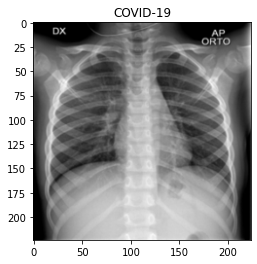

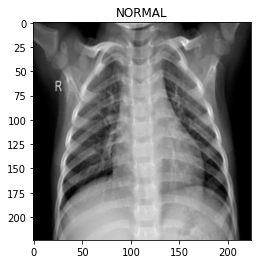

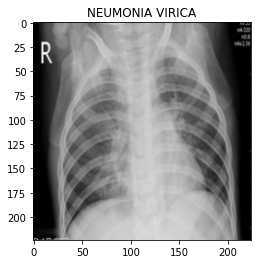

In [ ]:
#Un ejemplo del dataset de imágenes
pintaI(imgs_covid[4],0, 'COVID-19')
pintaI(imgs_normal[4],0, 'NORMAL')
pintaI(imgs_viral[4],0, 'NEUMONIA VIRICA')


Vamos a crear ahora los conjuntos de entrenamiento y de test, en base a las imágenes que hemos leído. La partición que tenemos actualmente puede hacer que se consigan resultados muy buenos, hay que probar con otro tipo de particiones a ver si es cosa de que el problema en sí es muy fácil de predecir, o a caso es que estamos incluyendo elementos que hacen más fácil la predicción, como varias imágenes de la misma persona tanto en entrenamiento como en test

In [ ]:
"""-------------Creamos los conjuntos de train y test ----------------------"""

#Creamos un array con todas las imágenes
imagenes = np.concatenate((imgs_covid, imgs_normal, imgs_viral), axis=0)

# Pasamos los vectores de las clases a matrices 
# Para ello, primero pasamos las clases a números enteros
clases_posibles = ["COVID","NORMAL","Viral Pneumonia"]
for i in range(3):
  for j in range(len(clases)):
    if (clases[j] == clases_posibles[i]):
      clases[j] = i
      

# Después, usamos la función to_categorical()
clases = np_utils.to_categorical(clases, num_classes=3)

# Barajar los datos
imagenes_perm = np.random.permutation(len(imagenes))
imagenes = imagenes[imagenes_perm]
clases = clases[imagenes_perm]

#Separamos los datos en train y test con una proporción de 80-20 %
sep = int (3*num_imgs*0.8)
x_train = imagenes[:sep]
y_train = clases[:sep]

x_test = imagenes[sep:]
y_test = clases[sep:]

print("Cantidad de datos por conjunto:\n train: ", len(x_train), "\n test: ", len(x_test))

Cantidad de datos por conjunto:
 train:  2880 
 test:  720


Cosas fundamentales a hacer y explicar en el PDF:

- Hacer image normalization.
 - La normalización debería ser featurewise (en todo el conjunto de entrenamiento) como mínimo, medida 0 y desviación 1.
 -Hay imágenes que salen muy blancas y otras imágenes que salen muy oscuras, y por lo tanto deberíamos conseguir invarianza frente al brillo, por lo que añado el parámetro de brightness.
 -Se entiende que los pulmones siempre se sacan verticales, por lo que no tiene mucho sentido añadir rotaciones, pero sí flips horizontales.
 -Zooms de ampliación pueden ser interesantes, puesto que las imágenes tienen siempre los pulmones en la zona central, y podemos evitar posibles fuentes de ruido de letras que tienen algunas de las imágenes en las zonas laterales, que se perderán haciendo zoom.

- Discutir más tipos de data augmentation, si puede hacerse algo sobre inspiración y expiración.

#Modelo basado en DenseNet121

Vamos a comenzar usando esta red, preentrenada con IMAGENET, como base para desarrollar nuestro modelo.

Definición inicial del modelo:

In [ ]:
#Definición inicial de nuestro modelo preentrenado en imagenet.
#Para usarlo como extractor de características simple

#Vamos a cargar el modelo antes del ultimo pooling, para usarlo como extractor de caracteristicas
feat_extractor = DenseNet121(include_top=False, weights='imagenet', pooling='avg')
feat_extractor.trainable = False

#Una vez tenemos el modelo, vamos a compilarlo usando un optimizador y una funcion de perdida
opt = SGD(lr=0.01, decay= 1e-6, momentum=0.9, nesterov=True)

feat_extractor.compile(optimizer=opt, loss="categorical_crossentropy", metrics=["acc"])

#Con esto tenemos el modelo de densenet hasta que nos deja los datos en forma de vector unidimensional
#de dimensión 1024
feat_extractor = keras.Model(inputs=feat_extractor.inputs, outputs= feat_extractor.layers[-1].output)

feat_extractor.compile(optimizer=opt, loss="categorical_crossentropy", metrics=["acc"])

# Extraer las características de las imágenes con el modelo anterior.
car_train = feat_extractor.predict(x_train, verbose=1)
car_test = feat_extractor.predict(x_test, verbose=1)

print(len(car_train))
print(len(car_train[0]))
print(len(car_test))
print(len(car_test[0]))


#feat_extractor.summary()

## Versión 0: Extractor de características inicial, sin entrenamiento
Primero vamos a utilizar el modelo DenseNet121 preentrenada con IMAGENET sin entrenar ningún peso. Partiendo de las características extraidas, simplemente vamos a añadir la capa softmax y comprobaremos que los resultados no son para nada buenos, pues todavía no hemos entrenado nuevos pesos, no estamos adaptando la red a nuestros datos en absoluto.

In [ ]:
inputs = keras.layers.Input(shape=[1024])
outputs = keras.layers.Dense(units=3, activation="softmax")(inputs)

dense_model = keras.Model(inputs=inputs, outputs=outputs)
opt = SGD(lr=0.01, decay= 1e-6, momentum=0.9, nesterov=True)
dense_model.compile(optimizer=opt, loss="categorical_crossentropy", metrics=["acc"])

#Clasificamos
y_preds = dense_model.predict(car_test, verbose=True)

print("La accuracy del modelo es: " + str(calcularAccuracy(y_test, y_preds)))

y_test_conf = np.argmax(y_test, axis=1)
y_preds = np.argmax(y_preds, axis=1)
print("La matriz de confusión de las predicciones ha sido: \n", confusion_matrix(y_test_conf, y_preds))


## Versión 1: Extractor de características inicial, entrenando la capa de salida
Ahora vamos a reentrenar sólo la capa de salida, sin ningún tratamiento adicional.



Definir el modelo a entrenar y ejecutarlo

Epoch 1/20
81/81 [==============================] - 1s 6ms/step - loss: 39.2265 - acc: 0.6589 - val_loss: 3.1792 - val_acc: 0.9062
Epoch 2/20
81/81 [==============================] - 0s 4ms/step - loss: 3.1674 - acc: 0.8873 - val_loss: 1.9361 - val_acc: 0.9271
Epoch 3/20
81/81 [==============================] - 0s 2ms/step - loss: 2.2095 - acc: 0.9055 - val_loss: 1.5694 - val_acc: 0.9132
Epoch 4/20
81/81 [==============================] - 0s 2ms/step - loss: 3.0319 - acc: 0.8926 - val_loss: 2.9922 - val_acc: 0.9097
Epoch 5/20
81/81 [==============================] - 0s 2ms/step - loss: 1.5931 - acc: 0.9293 - val_loss: 1.9142 - val_acc: 0.9167
Epoch 6/20
81/81 [==============================] - 0s 2ms/step - loss: 1.8569 - acc: 0.9218 - val_loss: 6.6220 - val_acc: 0.7674
Epoch 7/20
81/81 [==============================] - 0s 3ms/step - loss: 2.5723 - acc: 0.8999 - val_loss: 2.2121 - val_acc: 0.8924
Epoch 8/20
81/81 [==============================] - 0s 2ms/step - loss: 1.8145 - acc: 0.9

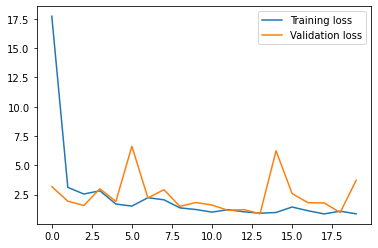

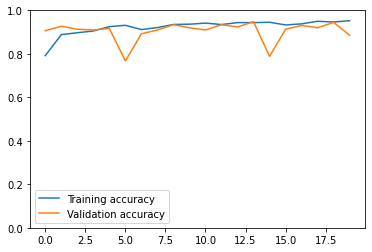

23/23 [==============================] - 0s 1ms/step
La accuracy del modelo es: 0.8930555555555556
La matriz de confusión de las predicciones ha sido: 
 [[203  21  11]
 [  0 244   0]
 [  2  43 196]]


In [ ]:
#Modelo denso
inputs = keras.layers.Input(shape=[1024])
outputs = keras.layers.Dense(units=3, activation="softmax")(inputs)

dense_model = keras.Model(inputs=inputs, outputs=outputs)
opt = SGD(lr=0.01, decay= 1e-6, momentum=0.9, nesterov=True)
dense_model.compile(optimizer=opt, loss="categorical_crossentropy", metrics=["acc"])

#Lo entrenamos
hist = dense_model.fit(car_train, y_train, batch_size=32, epochs=20, validation_split=0.1)
mostrarEvolucion(hist)

#Clasificamos
y_preds = dense_model.predict(car_test, verbose=True)

print("La accuracy del modelo es: " + str(calcularAccuracy(y_test, y_preds)))

y_test_conf = np.argmax(y_test, axis=1)
y_preds = np.argmax(y_preds, axis=1)
print("La matriz de confusión de las predicciones ha sido: \n", confusion_matrix(y_test_conf, y_preds))

Como podemos ver, los resultados son bastante buenos, conseguimos un 90% de accuracy en los conjuntos tanto de validación como de test. Esto nos llevará a no enfocar el estudio tanto a mejorar la calidad de la red, sino a obtener otro tipo de información de interés y hacer otras comprobaciones y análisis comparativos.

- En primer lugar, intentaremos mejorar la calidad de la red obtenida con otras técnicas un poco más sofisticadas, ya que la que hemos empleado ahora mismo es extremadamente simple, y entendemos que todavía hay bastante margen de mejora.

- En segundo lugar, intentaremos, sobre la red que nos haya dado mejores resultados, intentar comprender qué información se extrae de la red, visualizando los campos receptivos de algunas neuronas para las imágenes que mayor activación hayan dado en ellas.

- Realizaremos también un estudio comparativo entre utilizar diferentes tipos de redes como base. Inicialmente hemos usado Densenet121, pero hay otras muchas redes que keras nos aporta ya preentrenadas en imagenet, con lo que podremos comparar sus funcionamientos dentro del mismo problema.

- Intentar hacer una red desde cero (from scratch) y comparar la calidad en las predicciones obtenidas con las de los modelos preentrenados que hemos estado viendo

## Version 2: Data augmentation, más capas densas
Seguimos empleando la red preentreanda como extractor de características pero se realiza un preprocesado más exhaustivo de imágenes, con image augmentation y normalización, además de hacer un modelo denso de mayor profundidad. 

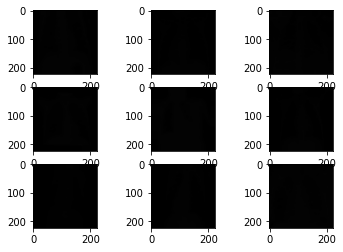

In [ ]:
#Image data generators

train_generator = ImageDataGenerator(featurewise_center = True,
                             featurewise_std_normalization = True,
                             validation_split=0.1,
                             horizontal_flip=True,
                             brightness_range=[0.8,1.25],
                             zoom_range=[1,1.2])
train_generator.fit(x_train)

test_generator = ImageDataGenerator(featurewise_center = True,
                             featurewise_std_normalization = True)

test_generator.fit(x_train)

it = train_generator.flow(x_train, batch_size=1)

In [ ]:
#Definición inicial de nuestro modelo preentrenado en imagenet.
#Para usarlo como extractor de características simple

#Vamos a cargar el modelo antes del ultimo pooling, para usarlo como extractor de caracteristicas
feat_extractor = DenseNet121(include_top=False, weights='imagenet', pooling='avg', )

#Una vez tenemos el modelo, vamos a compilarlo usando un optimizador y una funcion de perdida
opt = SGD(lr=0.01, decay= 1e-6, momentum=0.9, nesterov=True)

feat_extractor.compile(optimizer=opt, loss="categorical_crossentropy", metrics=["acc"])

#Con esto tenemos el modelo de densenet hasta que nos deja los datos en forma de vector unidimensional
#de dimensión 1024
feat_extractor = keras.Model(inputs=feat_extractor.inputs, outputs= feat_extractor.layers[-1].output)
feat_extractor.compile(optimizer=opt, loss="categorical_crossentropy", metrics=["acc"])

# Extraer las características de las imágenes con el modelo anterior.
car_train = feat_extractor.predict_generator(train_generator.flow(x_train, batch_size=1, shuffle=False),verbose=1, steps=len(x_train))
car_test = feat_extractor.predict_generator(test_generator.flow(x_test, batch_size=1, shuffle=False),verbose=1, steps=len(x_test))

#feat_extractor.summary()

/usr/local/lib/python3.6/dist-packages/tensorflow/python/keras/engine/training.py:1905: UserWarning: `Model.predict_generator` is deprecated and will be removed in a future version. Please use `Model.predict`, which supports generators.
  warnings.warn('`Model.predict_generator` is deprecated and '


720/720 [==============================] - 7s 10ms/step


Epoch 1/20
81/81 [==============================] - 1s 5ms/step - loss: 0.5049 - acc: 0.8128 - val_loss: 0.2111 - val_acc: 0.9271
Epoch 2/20
81/81 [==============================] - 0s 3ms/step - loss: 0.1288 - acc: 0.9598 - val_loss: 0.1291 - val_acc: 0.9583
Epoch 3/20
81/81 [==============================] - 0s 3ms/step - loss: 0.1129 - acc: 0.9619 - val_loss: 0.1177 - val_acc: 0.9653
Epoch 4/20
81/81 [==============================] - 0s 3ms/step - loss: 0.0753 - acc: 0.9743 - val_loss: 0.1405 - val_acc: 0.9549
Epoch 5/20
81/81 [==============================] - 0s 2ms/step - loss: 0.0758 - acc: 0.9692 - val_loss: 0.1124 - val_acc: 0.9688
Epoch 6/20
81/81 [==============================] - 0s 2ms/step - loss: 0.0748 - acc: 0.9730 - val_loss: 0.1252 - val_acc: 0.9549
Epoch 7/20
81/81 [==============================] - 0s 3ms/step - loss: 0.0635 - acc: 0.9796 - val_loss: 0.1006 - val_acc: 0.9688
Epoch 8/20
81/81 [==============================] - 0s 3ms/step - loss: 0.0425 - acc: 0.98

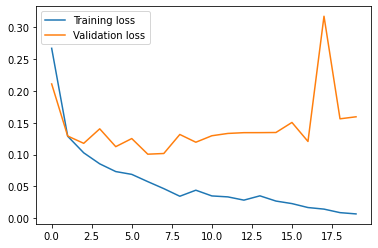

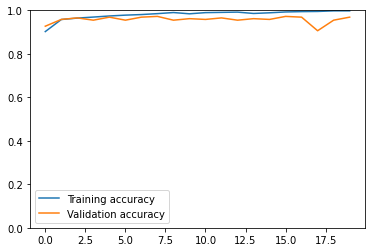

23/23 [==============================] - 0s 1ms/step
La accuracy del modelo es: 0.9513888888888888
La matriz de confusión de las predicciones ha sido: 
 [[232   2   1]
 [  1 239   4]
 [  2  25 214]]


In [ ]:
#Modelo denso
inputs = keras.layers.Input(shape=[1024])
layer1 = keras.layers.Dense(units=500, activation="relu")(inputs)
layer2 = keras.layers.Dense(units=200, activation="relu")(layer1)
outputs = keras.layers.Dense(units=3, activation="softmax")(layer2)

dense_model = keras.Model(inputs=inputs, outputs=outputs)
opt = SGD(lr=0.01, decay= 1e-6, momentum=0.9, nesterov=True)
dense_model.compile(optimizer=opt, loss="categorical_crossentropy", metrics=["acc"])

#Lo entrenamos
hist = dense_model.fit(car_train, y_train, batch_size=32, epochs=20, validation_split=0.1)
mostrarEvolucion(hist)

#Clasificamos
y_preds = dense_model.predict(car_test, verbose=True)

print("La accuracy del modelo es: " + str(calcularAccuracy(y_test, y_preds)))

y_test_conf = np.argmax(y_test, axis=1)
y_preds = np.argmax(y_preds, axis=1)
print("La matriz de confusión de las predicciones ha sido: \n", confusion_matrix(y_test_conf, y_preds))

En esta última versión 2 puede ser que tengamos un poco de overfitting puesto que el validation loss no decrece al mismo ritmo que el training loss.
Regularizamos añadiendo una capa de Dropout.

Epoch 1/20
81/81 [==============================] - 1s 4ms/step - loss: 0.5379 - acc: 0.7684 - val_loss: 0.1490 - val_acc: 0.9583
Epoch 2/20
81/81 [==============================] - 0s 3ms/step - loss: 0.1910 - acc: 0.9312 - val_loss: 0.1420 - val_acc: 0.9618
Epoch 3/20
81/81 [==============================] - 0s 3ms/step - loss: 0.1826 - acc: 0.9399 - val_loss: 0.1368 - val_acc: 0.9479
Epoch 4/20
81/81 [==============================] - 0s 3ms/step - loss: 0.1549 - acc: 0.9464 - val_loss: 0.1081 - val_acc: 0.9722
Epoch 5/20
81/81 [==============================] - 0s 3ms/step - loss: 0.1381 - acc: 0.9512 - val_loss: 0.1204 - val_acc: 0.9653
Epoch 6/20
81/81 [==============================] - 0s 3ms/step - loss: 0.1459 - acc: 0.9509 - val_loss: 0.1167 - val_acc: 0.9618
Epoch 7/20
81/81 [==============================] - 0s 3ms/step - loss: 0.1418 - acc: 0.9514 - val_loss: 0.1500 - val_acc: 0.9410
Epoch 8/20
81/81 [==============================] - 0s 3ms/step - loss: 0.1168 - acc: 0.96

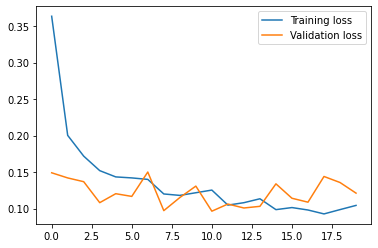

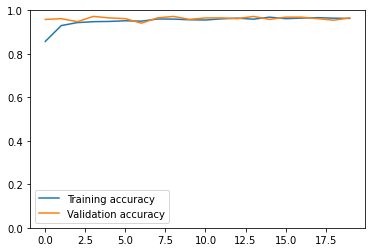

23/23 [==============================] - 0s 1ms/step
La accuracy del modelo es: 0.9555555555555556
La matriz de confusión de las predicciones ha sido: 
 [[231   2   2]
 [  1 240   3]
 [  0  24 217]]


In [ ]:
#Modelo denso
inputs = keras.layers.Input(shape=[1024])
layer1 = keras.layers.Dense(units=500, activation="relu")(inputs)
layer2 = keras.layers.Dropout(0.5)(layer1)
layer3 = keras.layers.Dense(units=200, activation="relu")(layer2)
outputs = keras.layers.Dense(units=3, activation="softmax")(layer3)

dense_model = keras.Model(inputs=inputs, outputs=outputs)
opt = SGD(lr=0.01, decay= 1e-6, momentum=0.9, nesterov=True)
dense_model.compile(optimizer=opt, loss="categorical_crossentropy", metrics=["acc"])

#Lo entrenamos
hist = dense_model.fit(car_train, y_train, batch_size=32, epochs=20, validation_split=0.1)
mostrarEvolucion(hist)

#Clasificamos
y_preds = dense_model.predict(car_test, verbose=True)

print("La accuracy del modelo es: " + str(calcularAccuracy(y_test, y_preds)))

y_test_conf = np.argmax(y_test, axis=1)
y_preds = np.argmax(y_preds, axis=1)
print("La matriz de confusión de las predicciones ha sido: \n", confusion_matrix(y_test_conf, y_preds))

##Version 3: Fine tunning

Vamos a probar ahora a hacer un ajuste fino de la red completa, tomando como pesos iniciales los de imagenet. Ahora ya no solo vamos a utilizar DenseNet como extractor de características, sino que, en vez de estar la red congelada, vamos a ir moviendo sus pesos con el entrenamiento

29089792/29084464 [==============================] - 0s 0us/step
Epoch 1/20
81/81 [==============================] - 57s 495ms/step - loss: 0.4450 - acc: 0.8188 - val_loss: 0.9364 - val_acc: 0.7465
Epoch 2/20
81/81 [==============================] - 38s 475ms/step - loss: 0.0940 - acc: 0.9663 - val_loss: 0.1141 - val_acc: 0.9653
Epoch 3/20
81/81 [==============================] - 38s 475ms/step - loss: 0.0503 - acc: 0.9856 - val_loss: 0.1205 - val_acc: 0.9618
Epoch 4/20
81/81 [==============================] - 38s 475ms/step - loss: 0.0350 - acc: 0.9892 - val_loss: 0.2449 - val_acc: 0.9028
Epoch 5/20
81/81 [==============================] - 38s 475ms/step - loss: 0.0435 - acc: 0.9849 - val_loss: 0.0949 - val_acc: 0.9757
Epoch 6/20
81/81 [==============================] - 38s 475ms/step - loss: 0.0250 - acc: 0.9914 - val_loss: 0.1588 - val_acc: 0.9375
Epoch 7/20
81/81 [==============================] - 38s 475ms/step - loss: 0.0160 - acc: 0.9947 - val_loss: 0.0727 - val_acc: 0.9722
Epoc

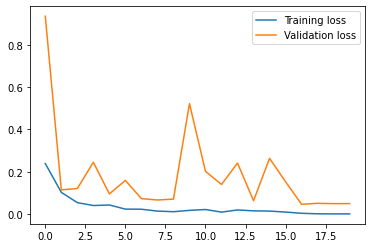

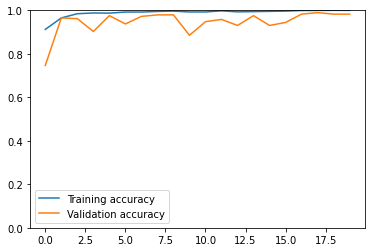

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, None, None,  0                                            
__________________________________________________________________________________________________
zero_padding2d (ZeroPadding2D)  (None, None, None, 3 0           input_1[0][0]                    
__________________________________________________________________________________________________
conv1/conv (Conv2D)             (None, None, None, 6 9408        zero_padding2d[0][0]             
__________________________________________________________________________________________________
conv1/bn (BatchNormalization)   (None, None, None, 6 256         conv1/conv[0][0]                 
______________________________________________________________________________________________

In [ ]:
#Fine Tunning
#Image data generators
train_generator = ImageDataGenerator(featurewise_center = True,
                             featurewise_std_normalization = True,
                             validation_split=0.1,
                             horizontal_flip=True,
                             brightness_range=[0.8,1.25],
                             zoom_range=[1,1.2])
train_generator.fit(x_train)

test_generator = ImageDataGenerator(featurewise_center = True,
                             featurewise_std_normalization = True)

test_generator.fit(x_train)

it = train_generator.flow(x_train, batch_size=1)

#Vamos a cargar el modelo antes del ultimo pooling, para usarlo como extractor de caracteristicas
denseNet = DenseNet121(include_top=False, weights='imagenet', pooling='avg', )

#Pesos sí entrenables
denseNet.trainable = True

#Modelo denso
layer1 = keras.layers.Dense(units=500, activation="relu")(denseNet.output)
layer2 = keras.layers.Dropout(0.25)(layer1)
layer3 = keras.layers.Dense(units=200, activation="relu")(layer2)
layer2 = keras.layers.Dropout(0.25)(layer1)
outputs = keras.layers.Dense(units=3, activation="softmax")(layer3)

model = keras.Model(inputs=denseNet.input, outputs=outputs)
opt = SGD(lr=0.01, decay= 1e-6, momentum=0.9, nesterov=True)
model.compile(optimizer=opt, loss="categorical_crossentropy", metrics=["acc"])

#Lo entrenamos
hist = model.fit(x_train, y_train, batch_size=32, epochs=20, validation_split=0.1)

mostrarEvolucion(hist)
#model.summary()
#Clasificamos
y_preds = dense_model.predict(x_test, verbose=True)

print("La accuracy del modelo es: " + str(calcularAccuracy(y_test, y_preds)))

y_test_conf = np.argmax(y_test, axis=1)
y_preds = np.argmax(y_preds, axis=1)
print("La matriz de confusión de las predicciones ha sido: \n", confusion_matrix(y_test_conf, y_preds))

Como podemos observar en la matriz de confusión, hemos conseguido casi un 99% de accuracy con nuestro modelo. Como vemos, sólo ha habido 9 ejemplos clasificados erróneamente en la matriz de confusión, y entendemos que la calidad de este modelo es ya bastante buena. Habiendo conseguido una mejora sustancial con respecto al modelo de extracción de características simple reentrenando sólo la capa de salida, el cual ya era de por sí bastante bueno, y una clasificación casi perfecta.

##Mapas de activación

Vamos a ver los mapas de activación para intentar detectar qué regiones de la imagen de entrada son las que se fija la red para dar la salida que da.

Vamos a usar las herramientas que nos proporcian keract.

In [ ]:
pip install keract

Vamos a tomar una imagen cualquiera y analizar su mapa de activación

input_1 (1, 224, 224, 3) 


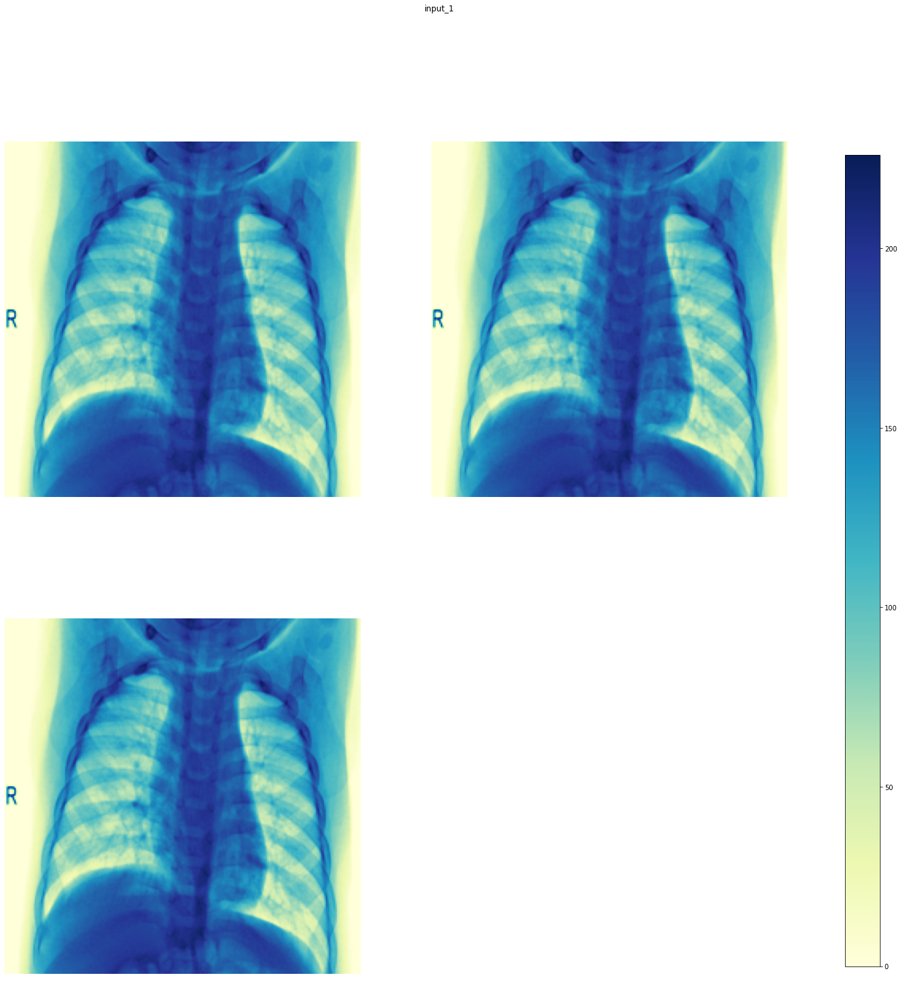

zero_padding2d (1, 230, 230, 3) 


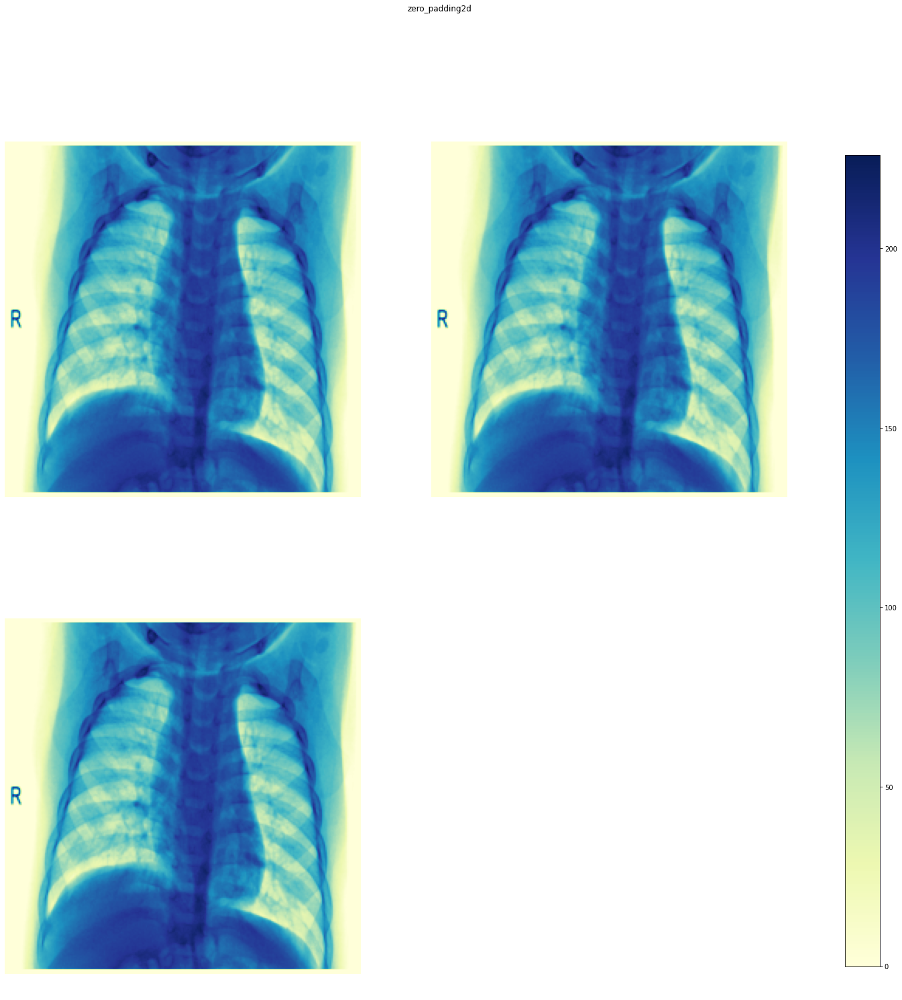

conv1/conv (1, 112, 112, 64) 


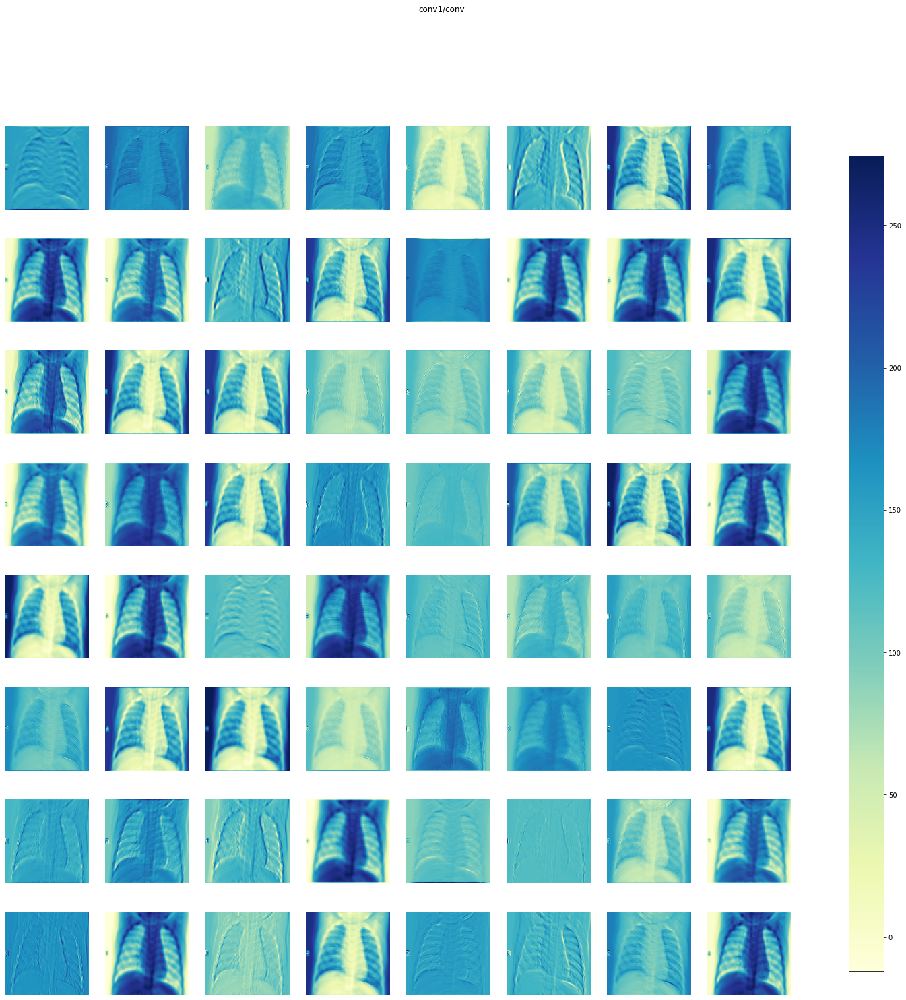

conv1/bn (1, 112, 112, 64) 


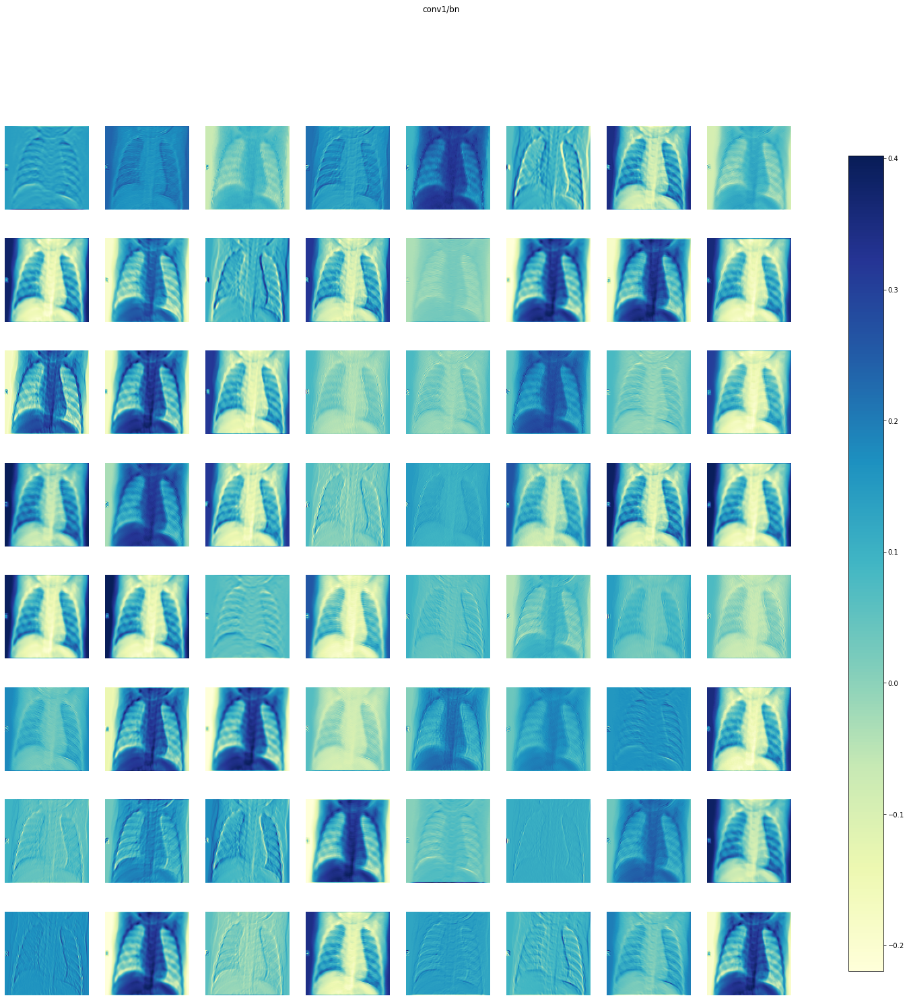

conv1/relu (1, 112, 112, 64) 


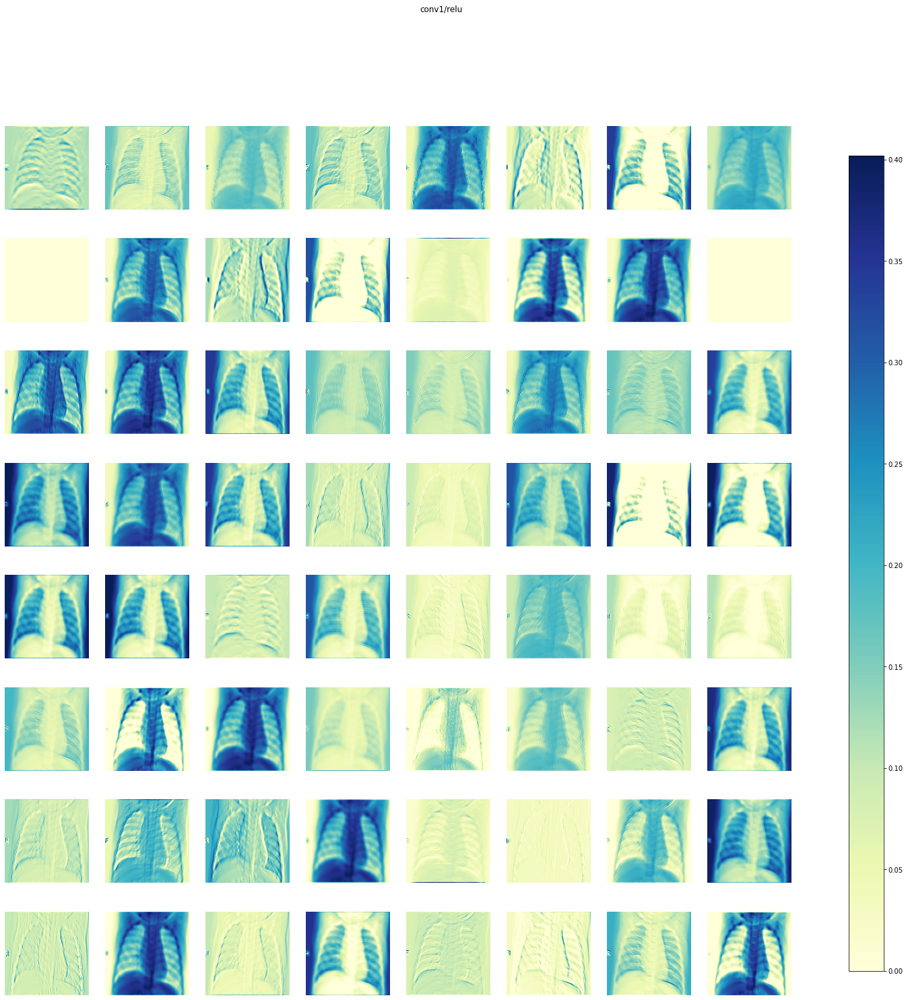

zero_padding2d_1 (1, 114, 114, 64) 


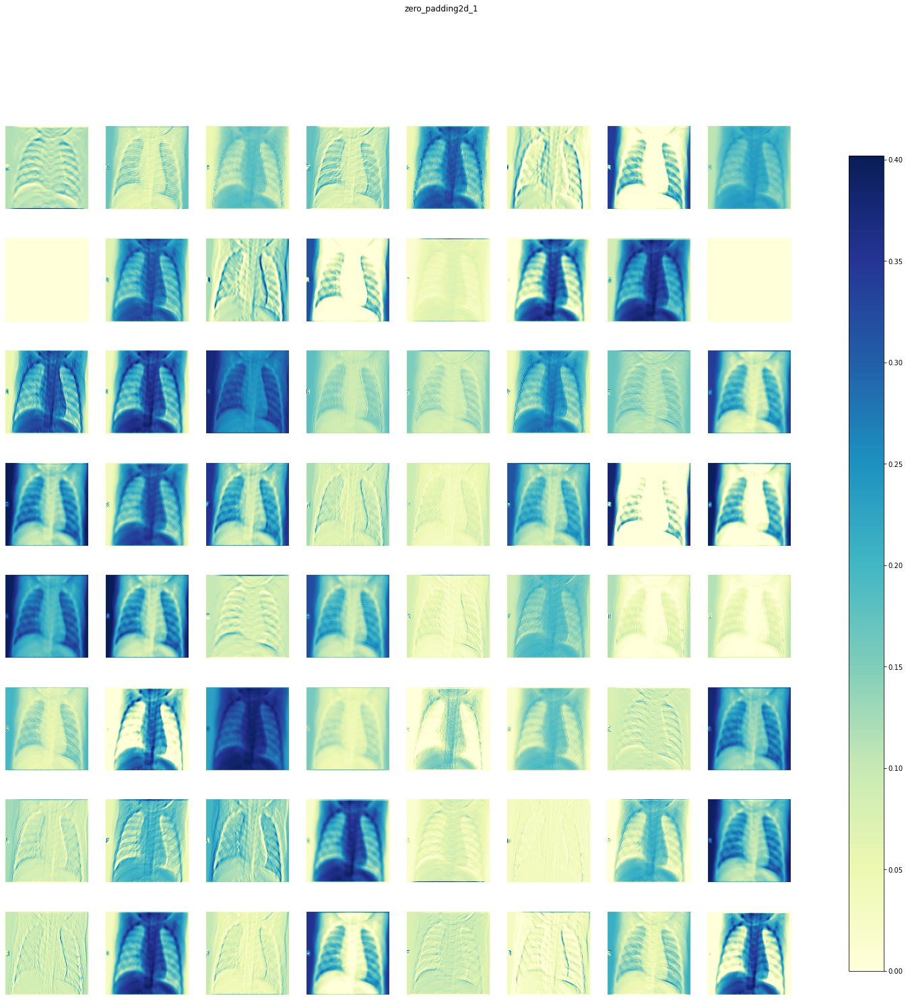

pool1 (1, 56, 56, 64) 


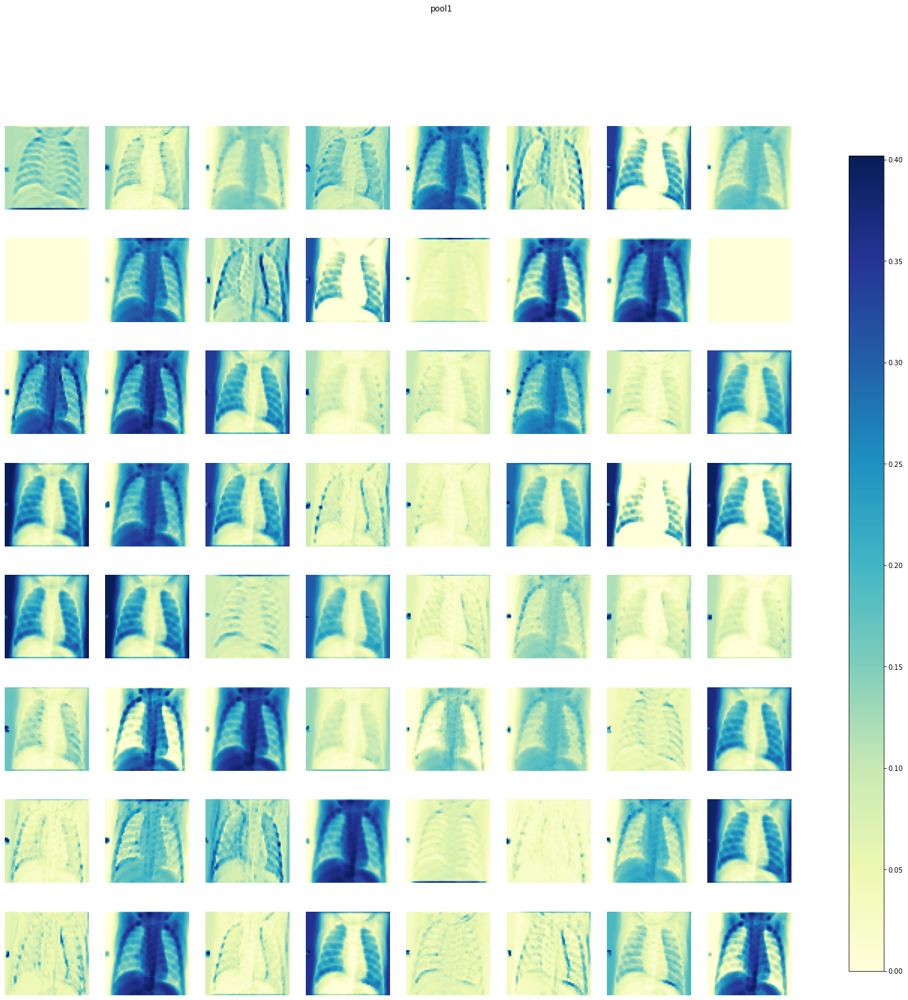

conv2_block1_0_bn (1, 56, 56, 64) 


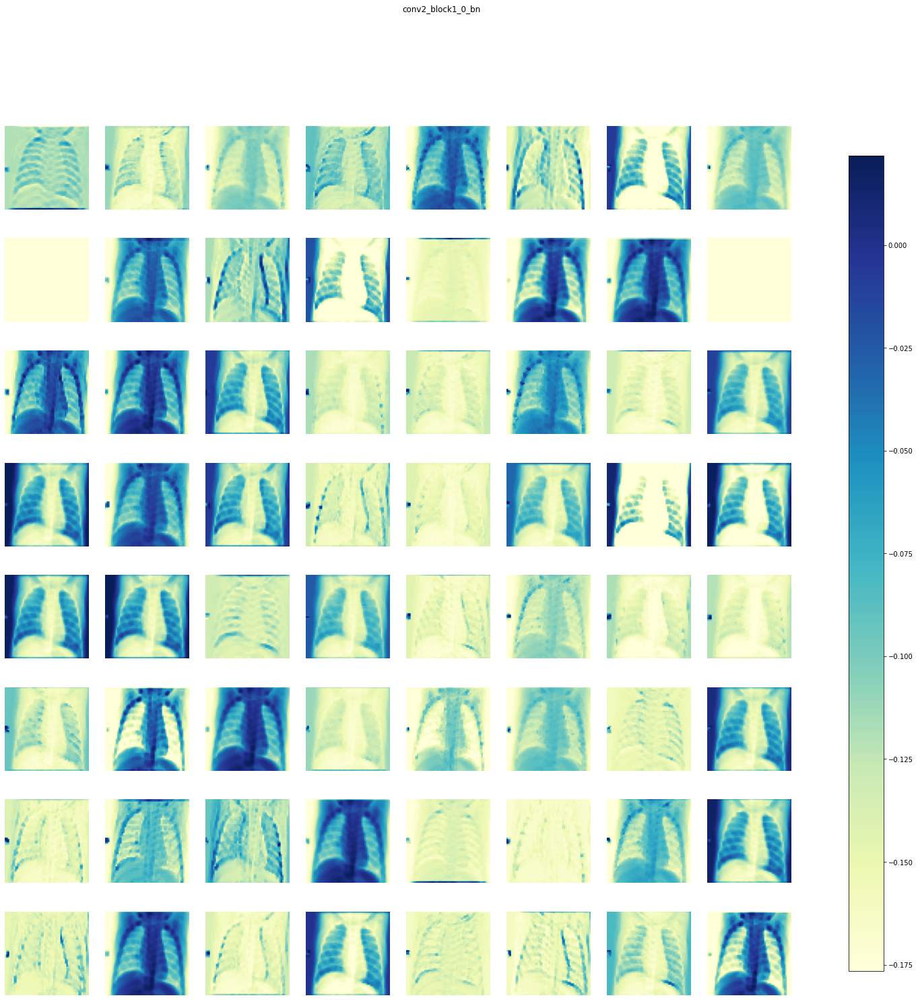

conv2_block1_0_relu (1, 56, 56, 64) 


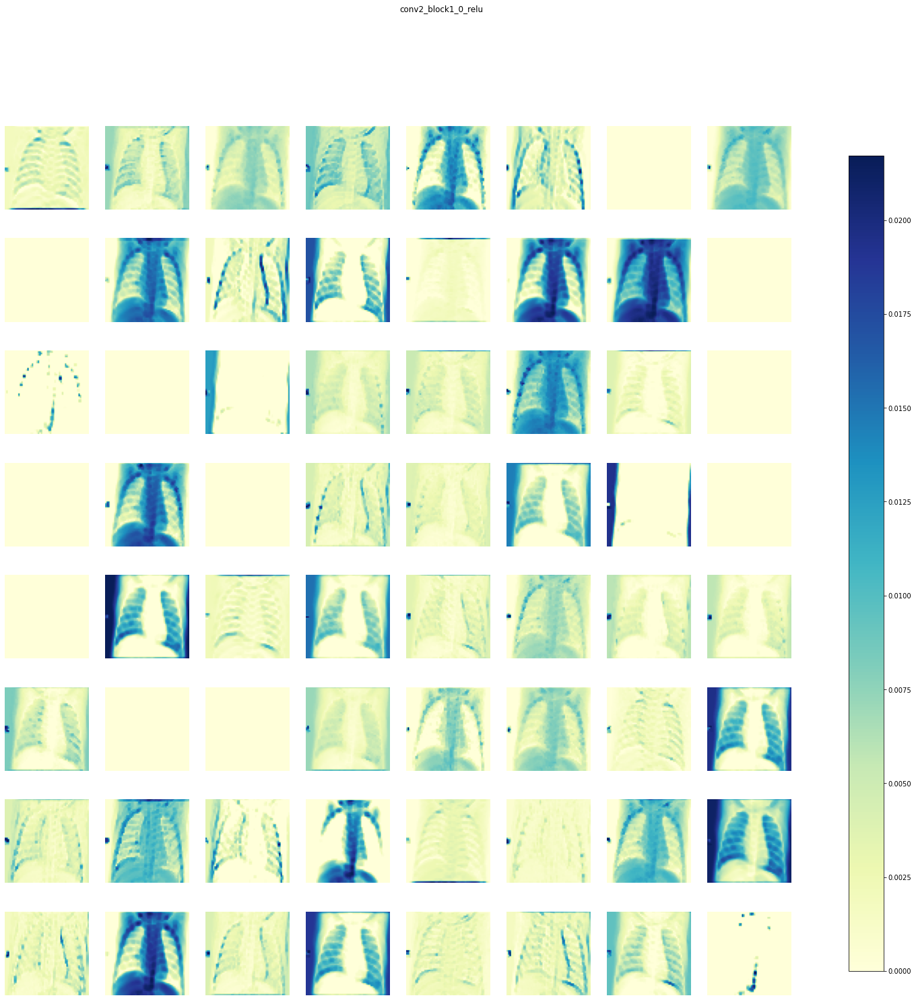

conv2_block1_1_conv (1, 56, 56, 128) 


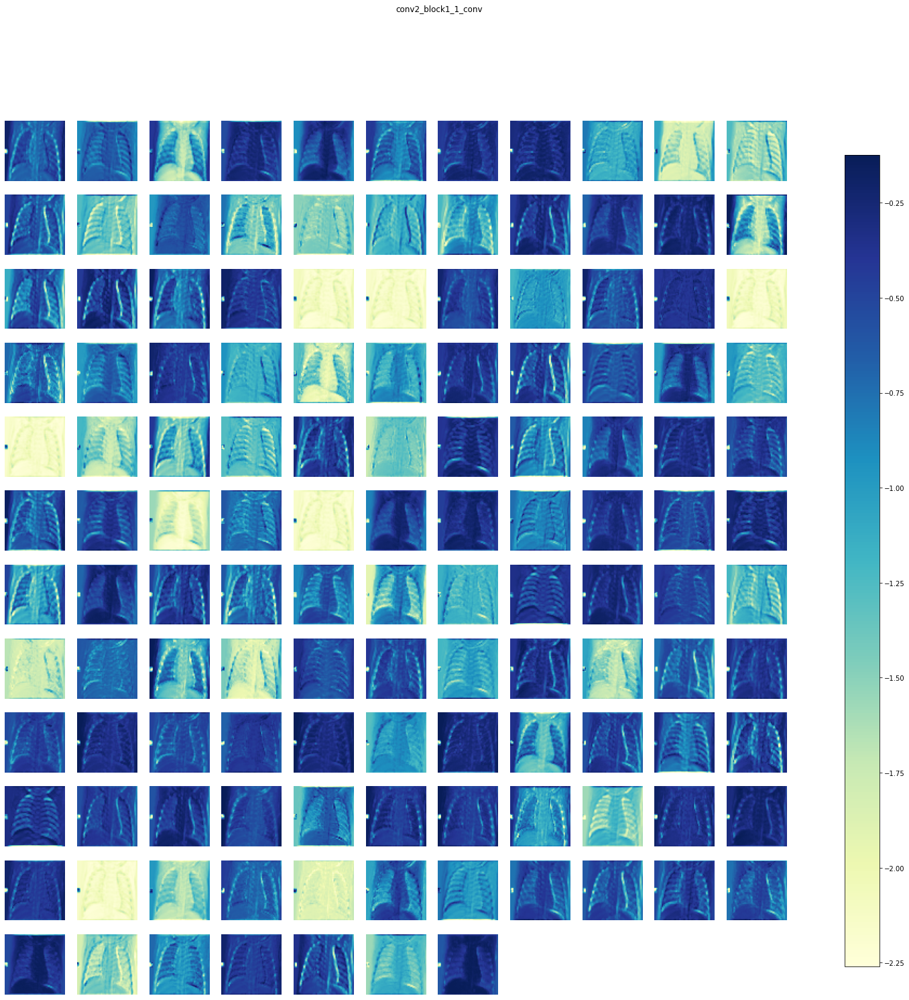

conv2_block1_1_bn (1, 56, 56, 128) 


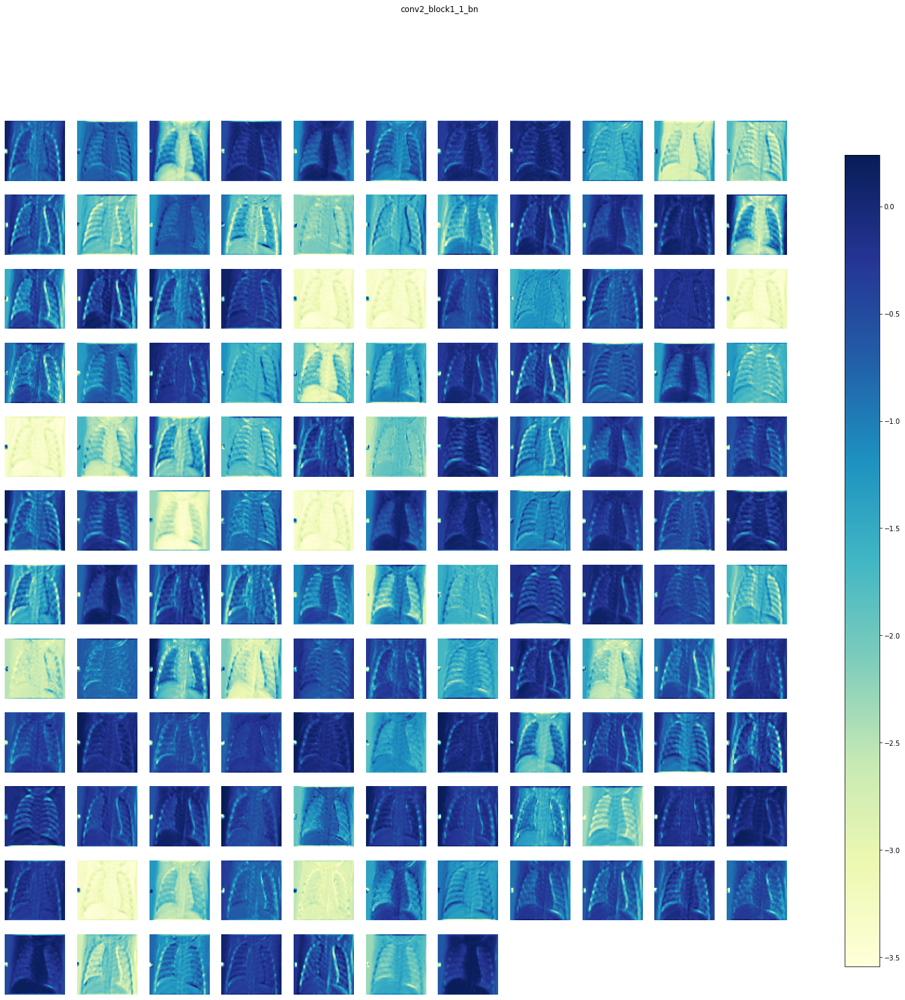

conv2_block1_1_relu (1, 56, 56, 128) 


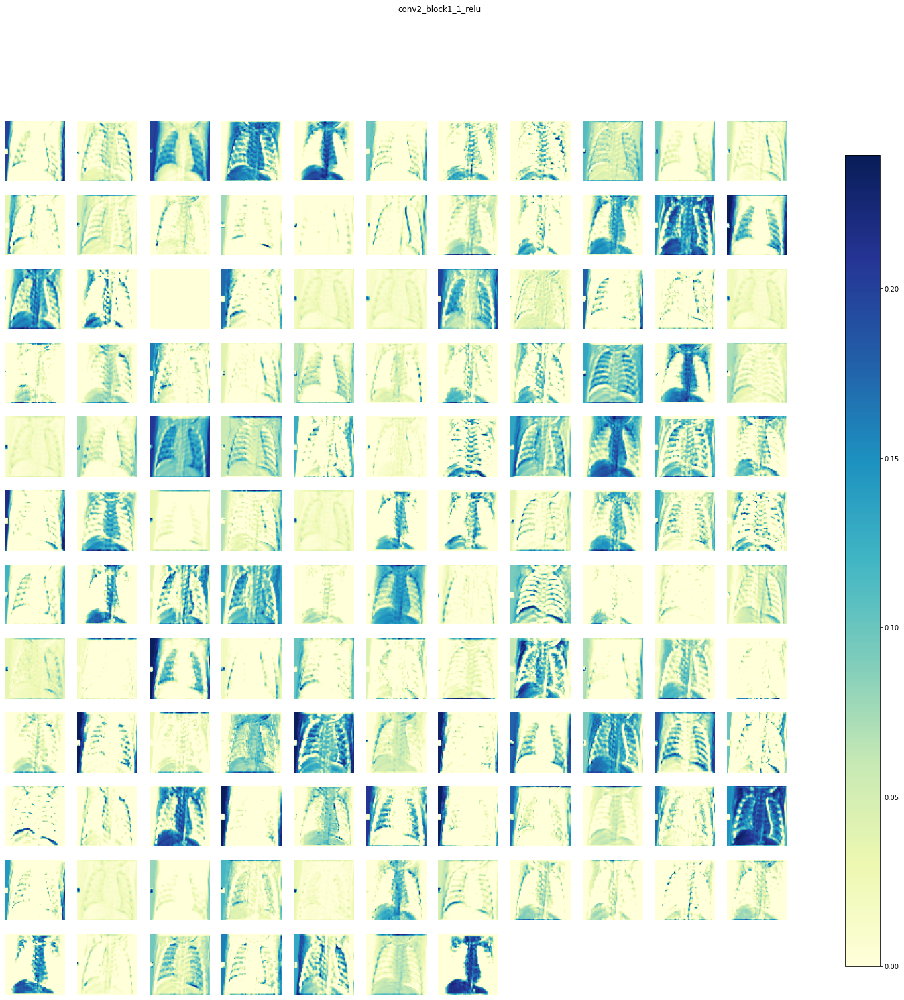

conv2_block1_2_conv (1, 56, 56, 32) 


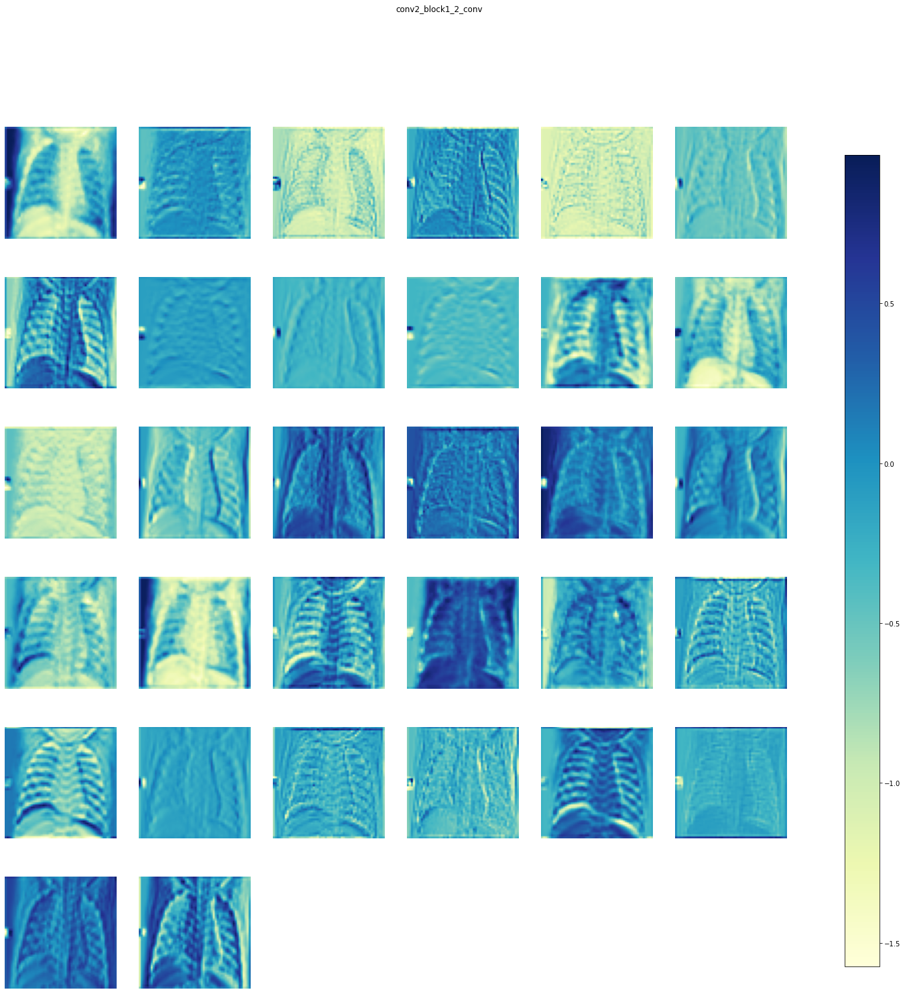

conv2_block1_concat (1, 56, 56, 96) 


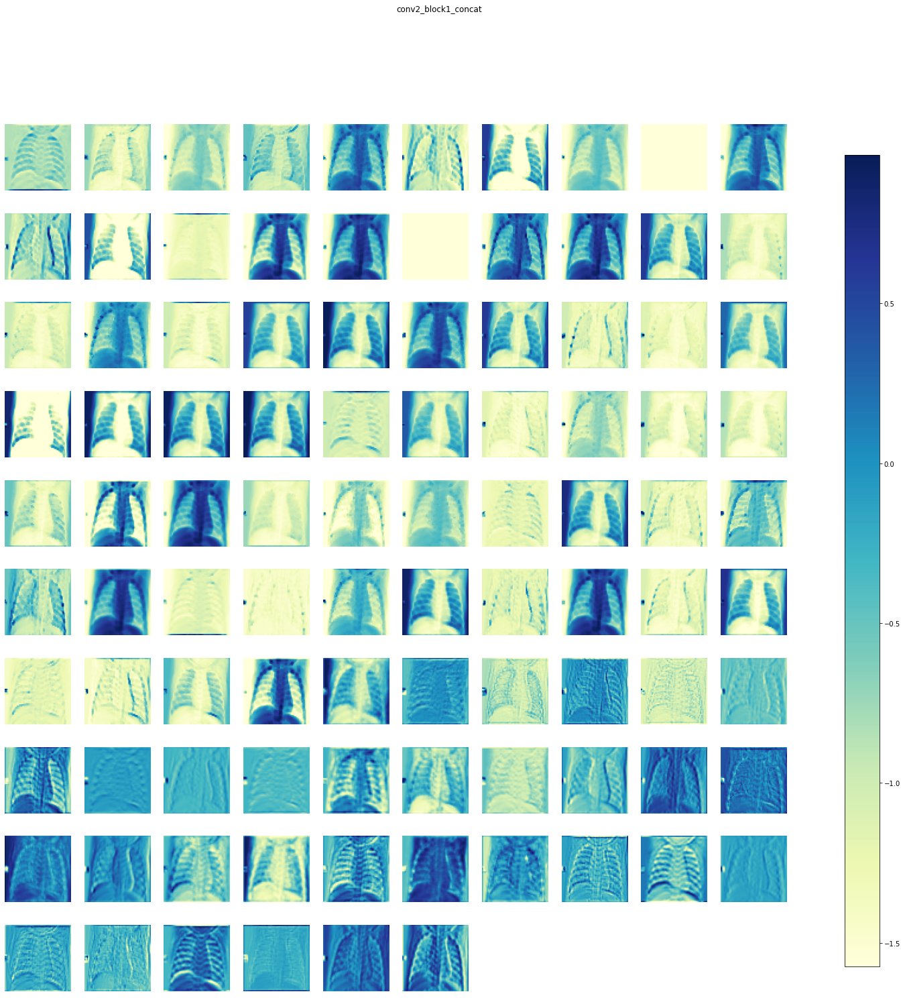

conv2_block2_0_bn (1, 56, 56, 96) 


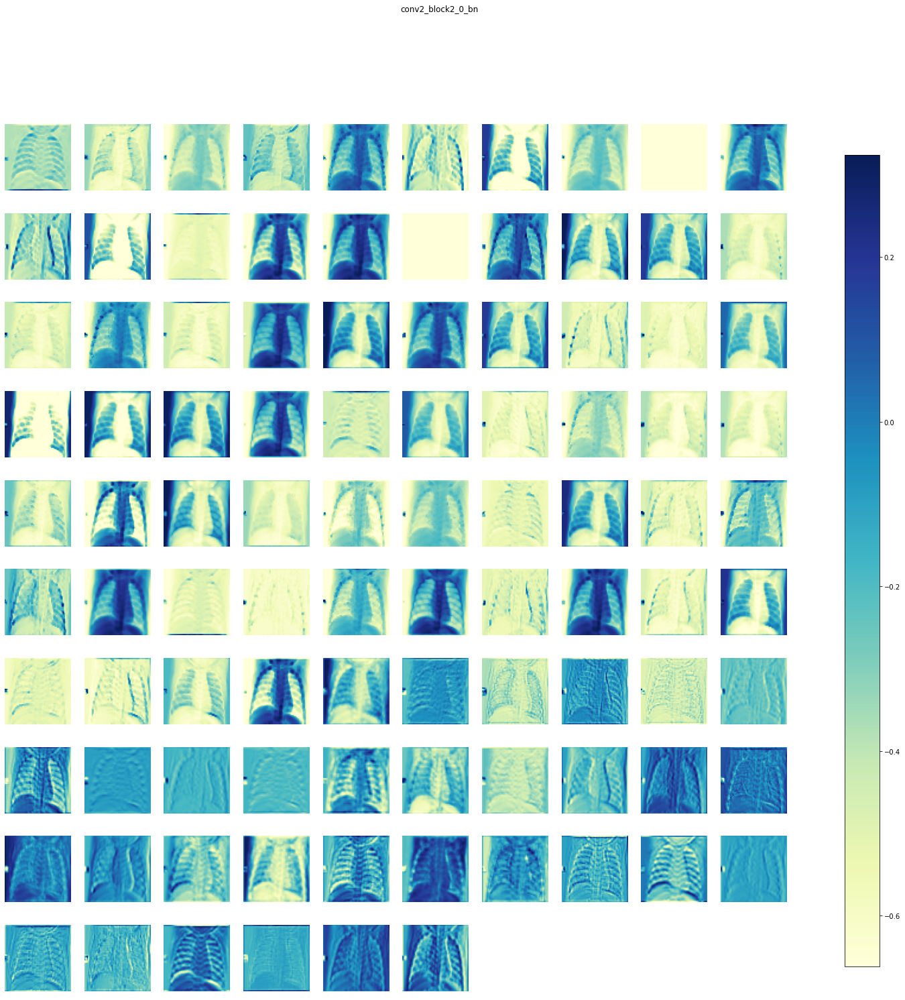

conv2_block2_0_relu (1, 56, 56, 96) 


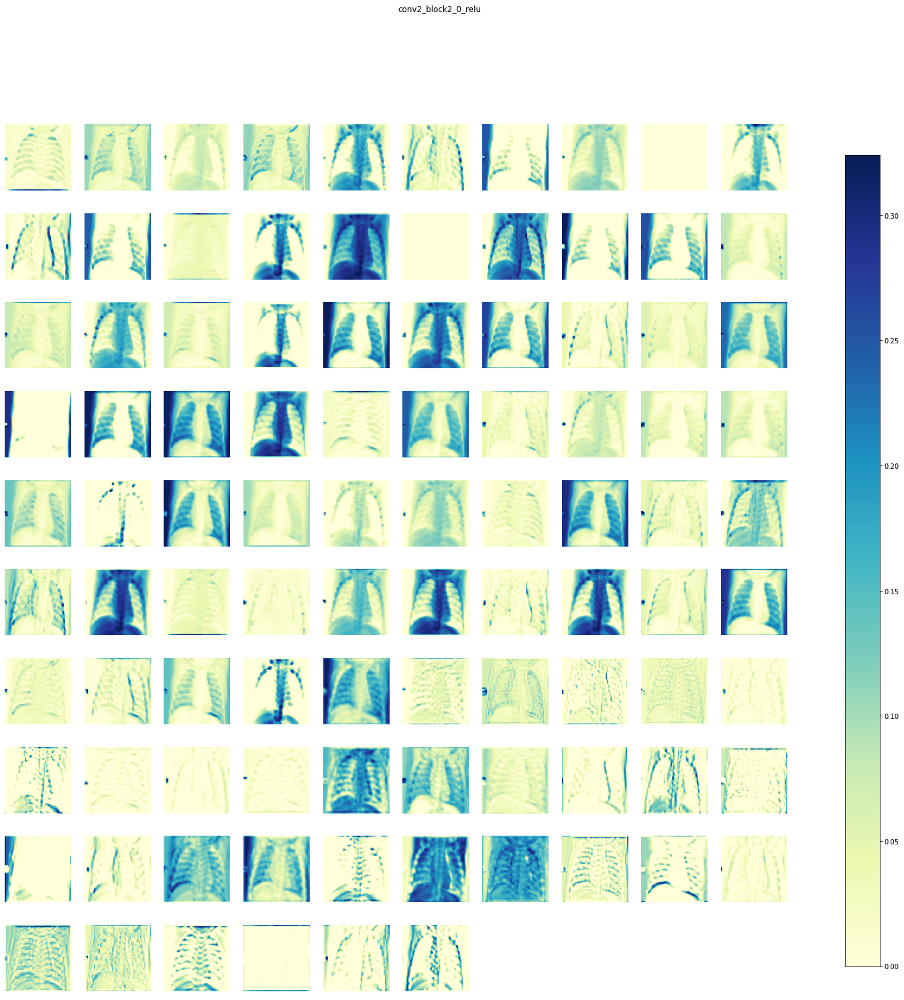

conv2_block2_1_conv (1, 56, 56, 128) 


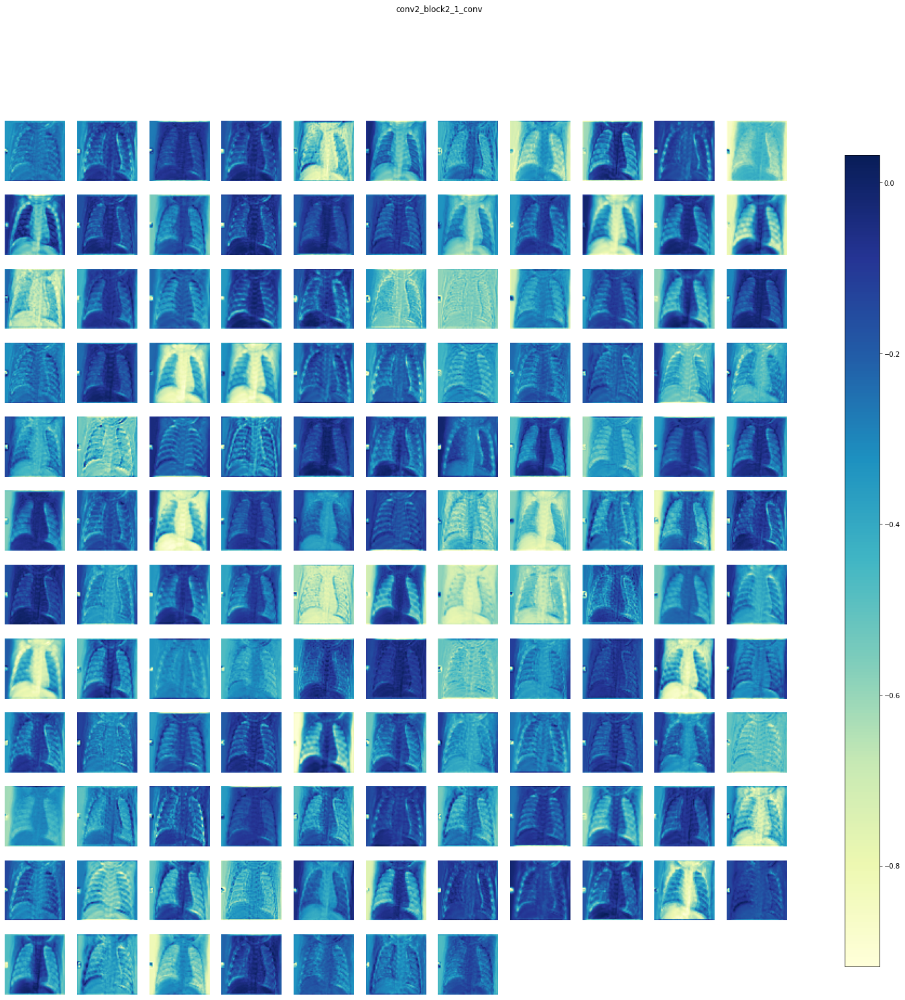

conv2_block2_1_bn (1, 56, 56, 128) 


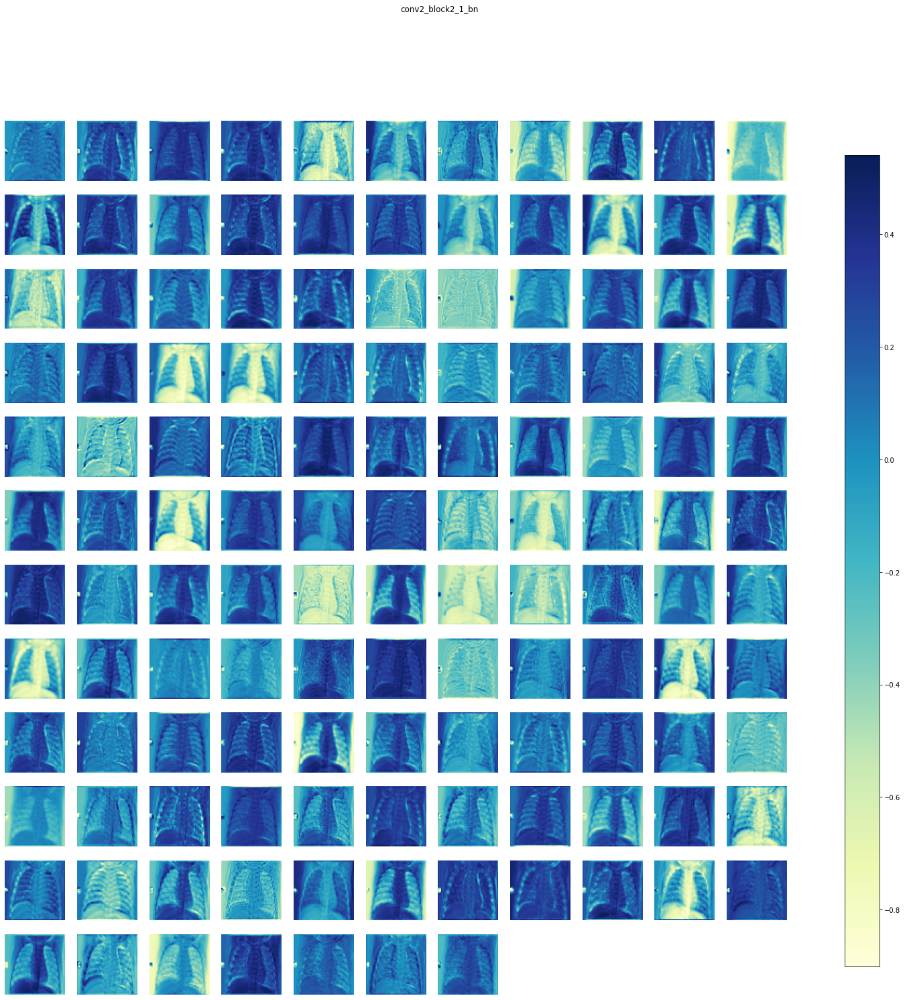

conv2_block2_1_relu (1, 56, 56, 128) 


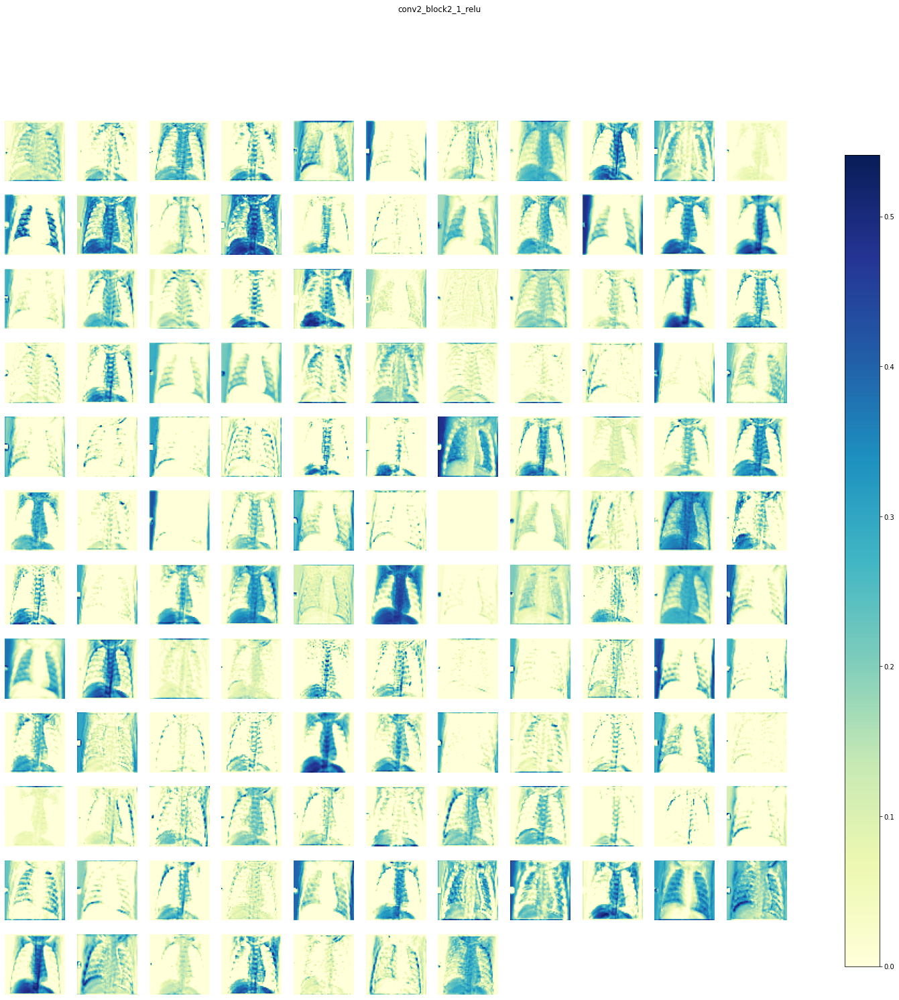

conv2_block2_2_conv (1, 56, 56, 32) 


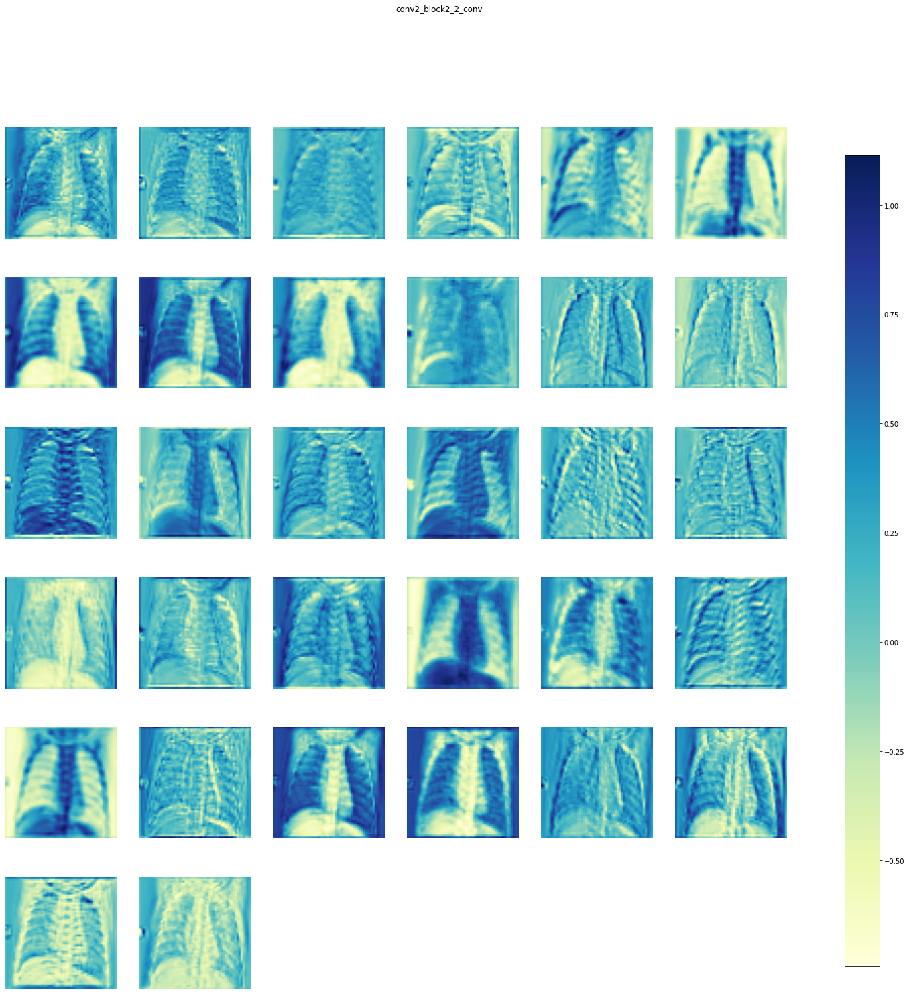

conv2_block2_concat (1, 56, 56, 128) 


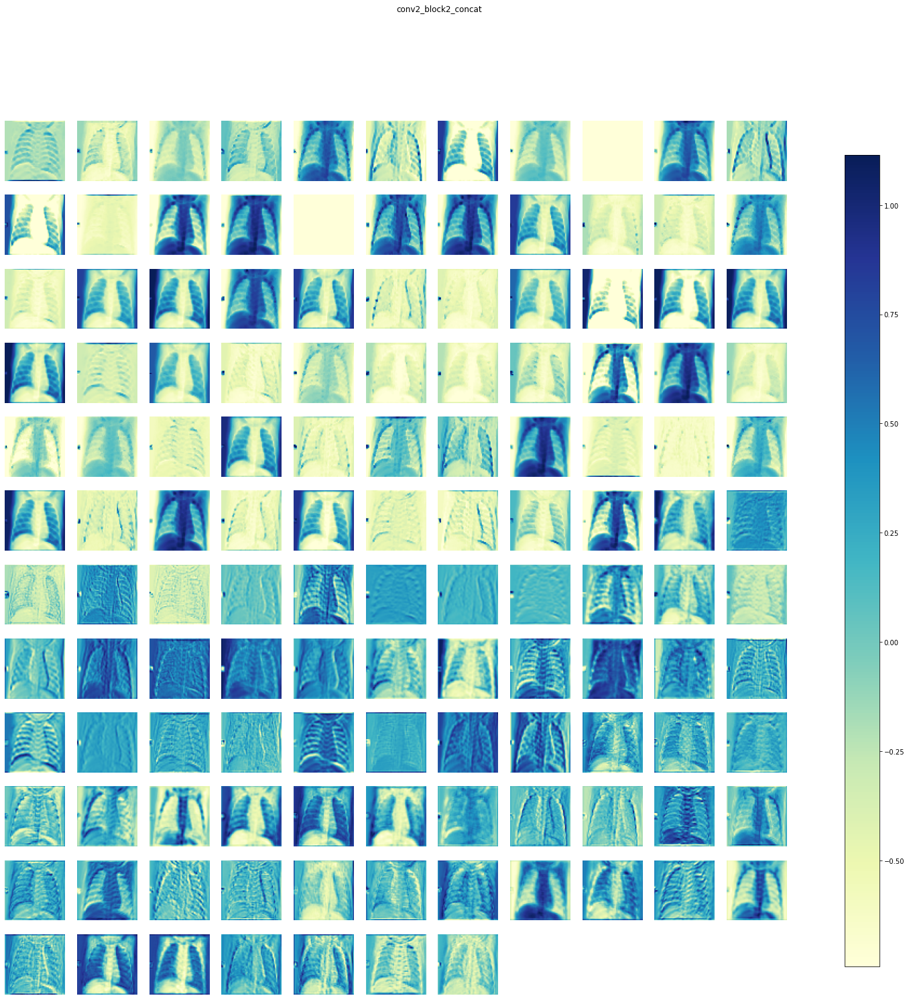

conv2_block3_0_bn (1, 56, 56, 128) 


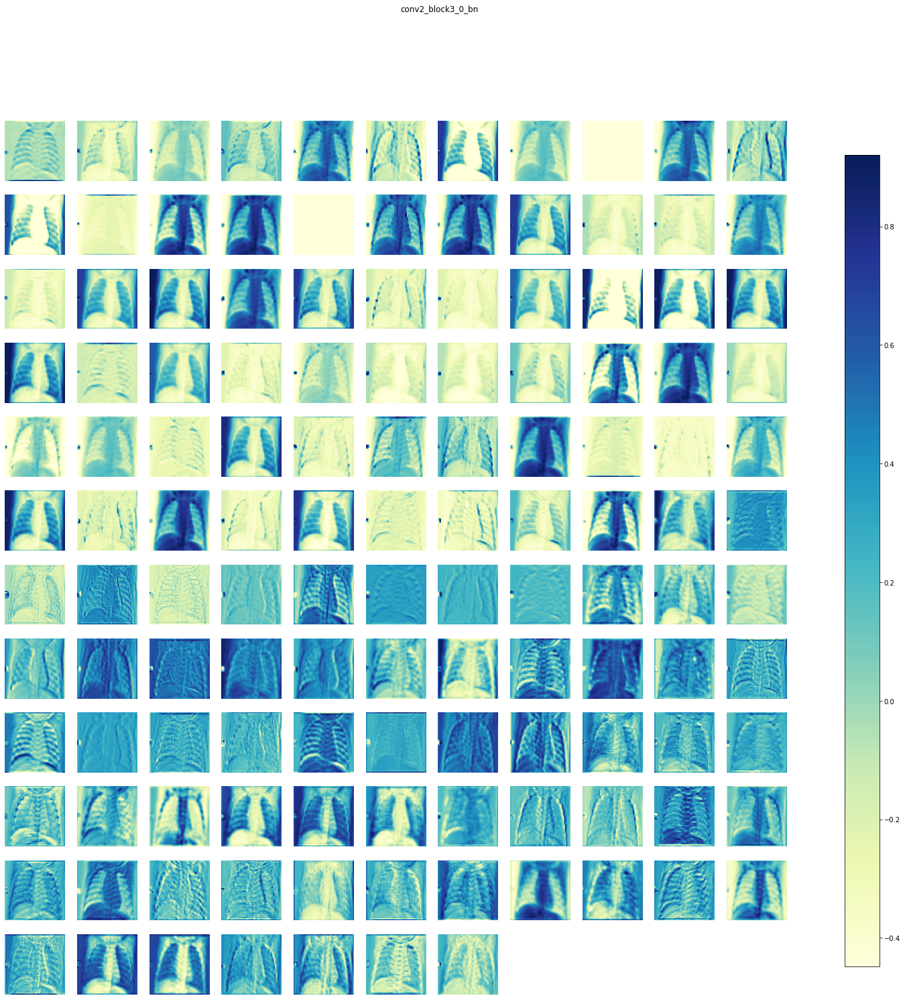

conv2_block3_0_relu (1, 56, 56, 128) 


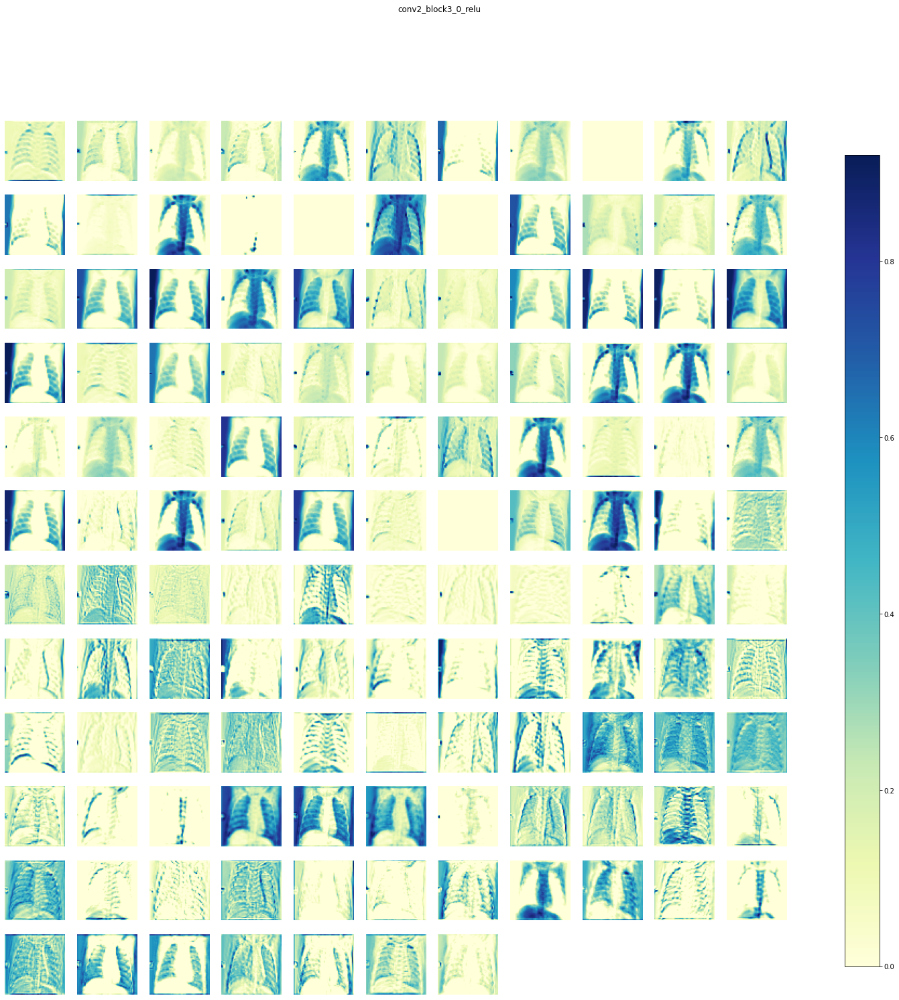

conv2_block3_1_conv (1, 56, 56, 128) 


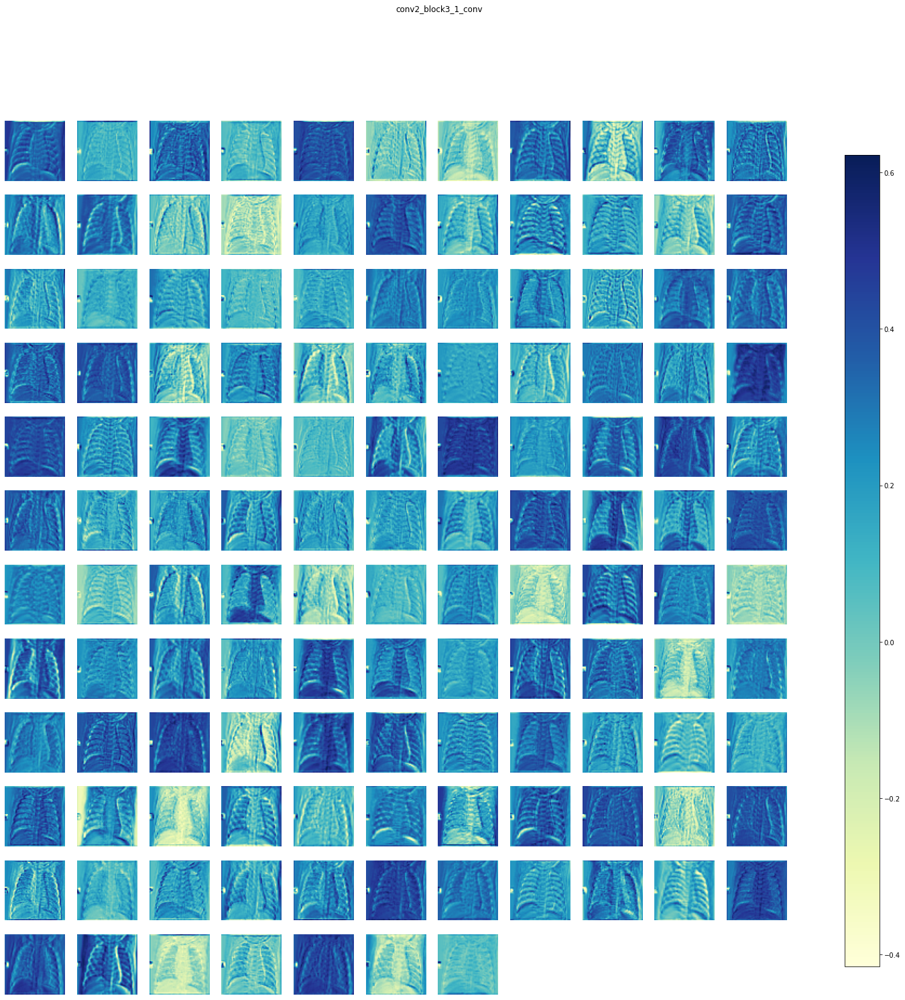

conv2_block3_1_bn (1, 56, 56, 128) 


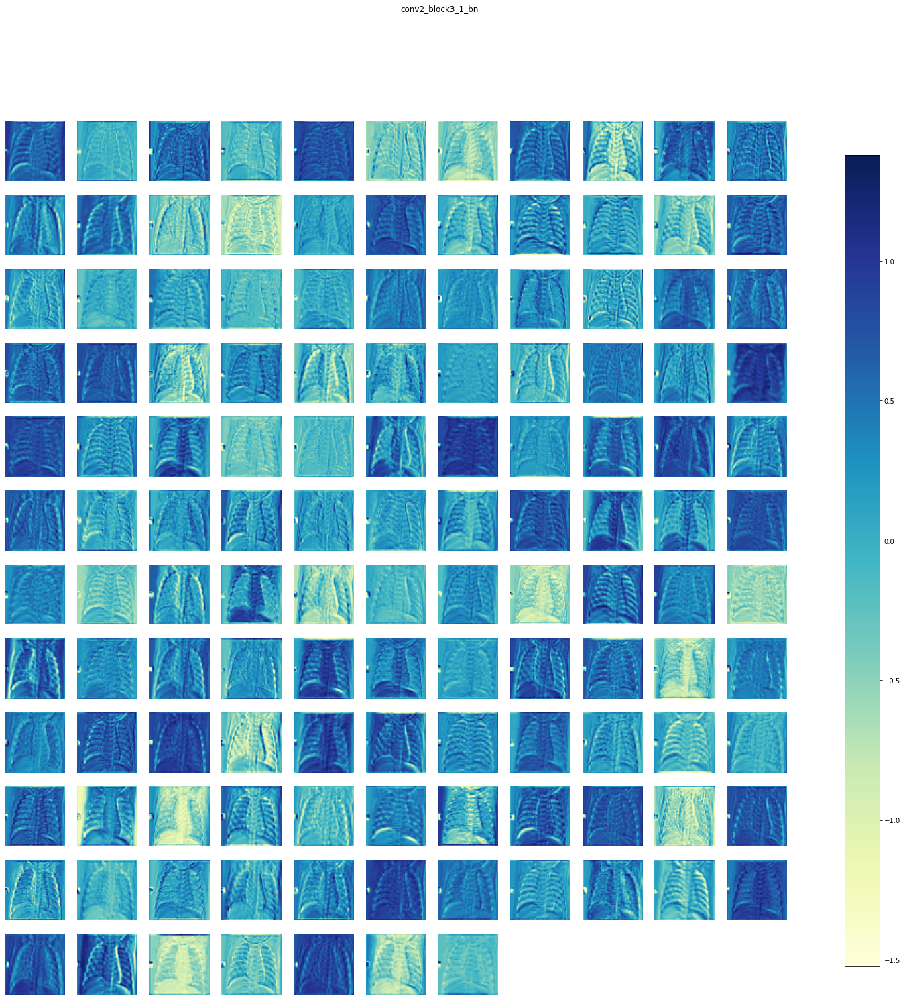

conv2_block3_1_relu (1, 56, 56, 128) 


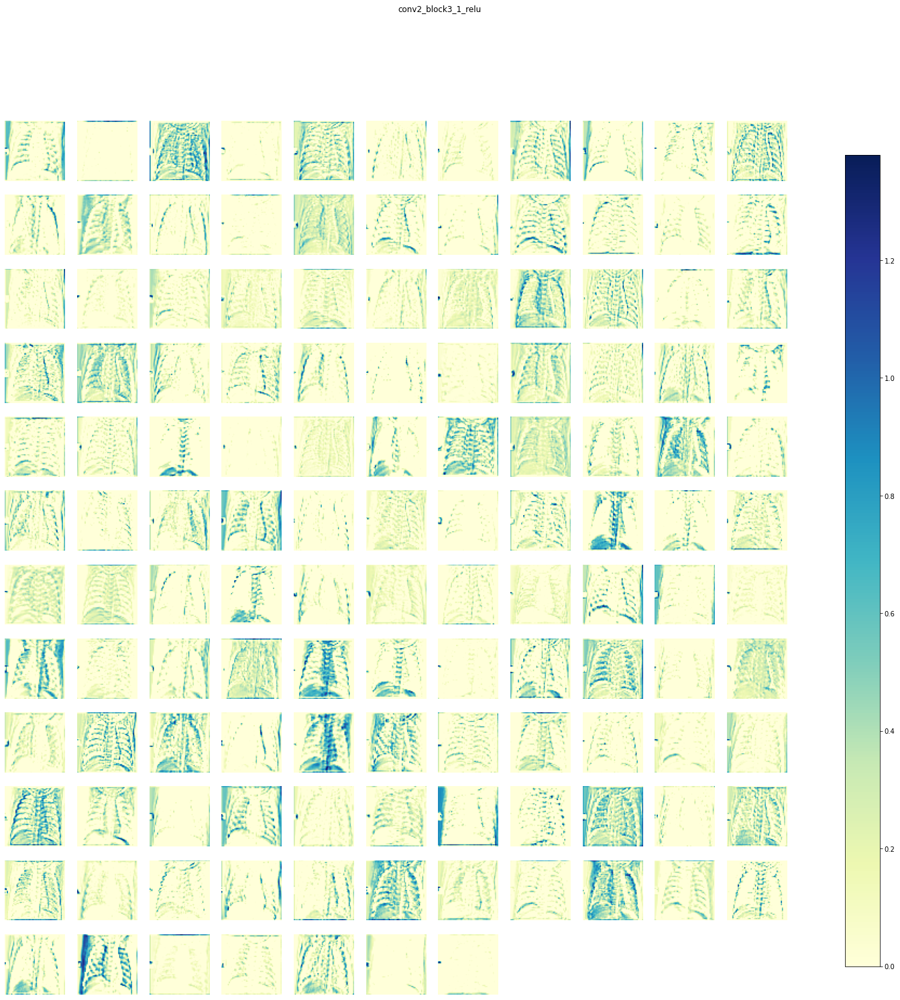

conv2_block3_2_conv (1, 56, 56, 32) 


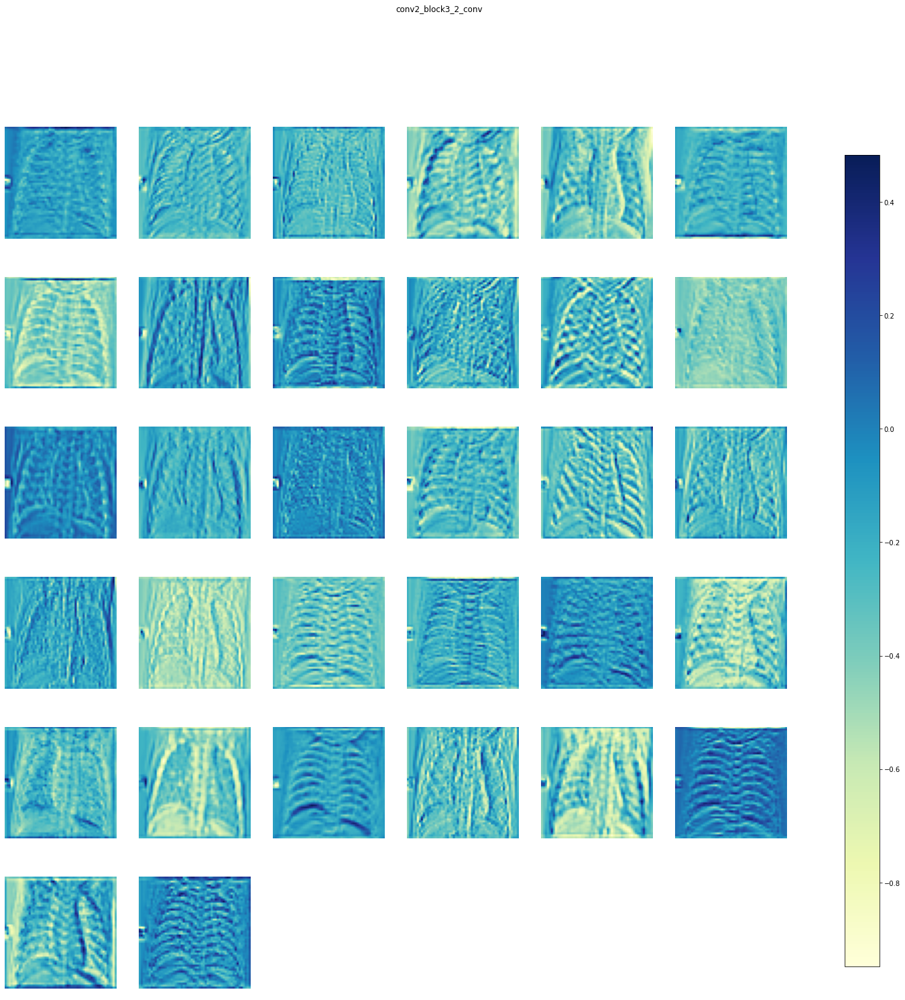

conv2_block3_concat (1, 56, 56, 160) 


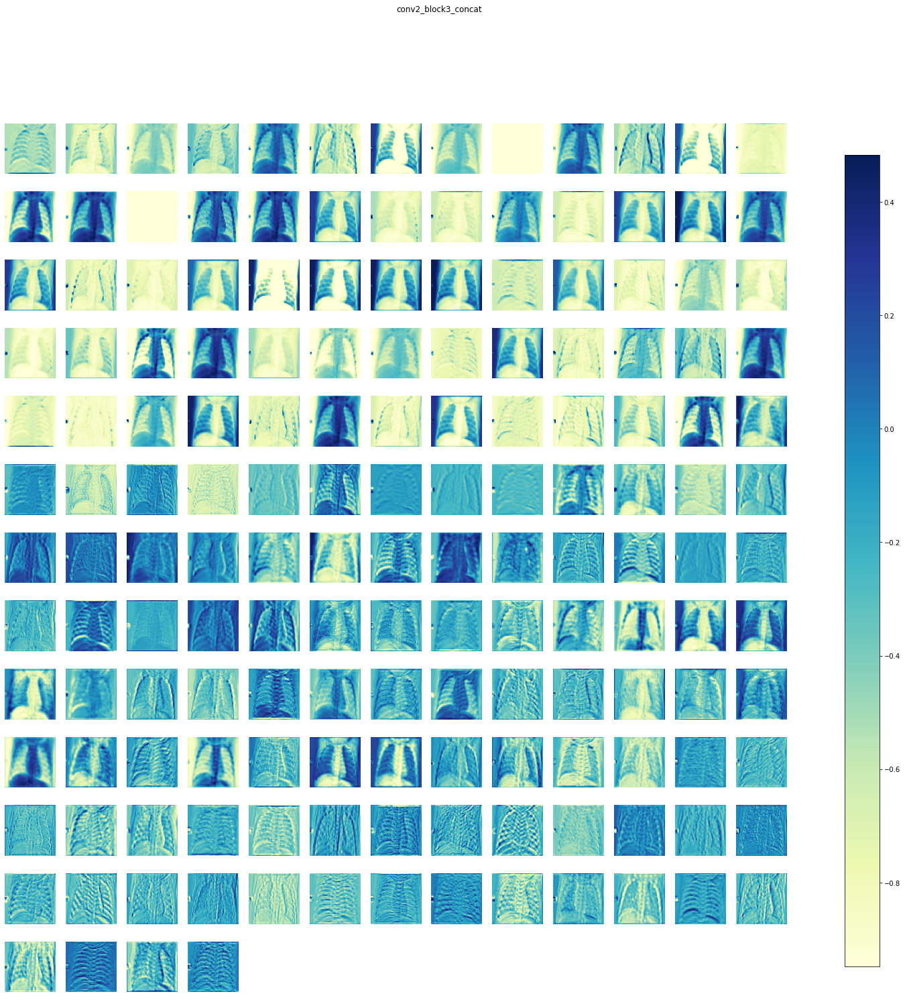

conv2_block4_0_bn (1, 56, 56, 160) 
Buffered data was truncated after reaching the output size limit.

In [ ]:
from keras import activations
from keract import get_activations, display_heatmaps, display_activations

keract_inputs = x_test[1:2]
keract_targets = y_test[:0]
activations = get_activations(dense_model, keract_inputs)
display_activations(activations=activations,cmap='YlGnBu')

#Partiendo de otros modelos base

#**ResNet50**

Definición inicial del modelo:

In [ ]:
#Image data generators

train_generator = ImageDataGenerator(featurewise_center = True,
                             featurewise_std_normalization = True,
                             validation_split=0.1,
                             horizontal_flip=True,
                             brightness_range=[0.8,1.25],
                             zoom_range=[1,1.2])
train_generator.fit(x_train)

test_generator = ImageDataGenerator(featurewise_center = True,
                             featurewise_std_normalization = True)

test_generator.fit(x_train)

it = train_generator.flow(x_train, batch_size=1)

#Definición inicial de nuestro modelo preentrenado en imagenet.
#Para usarlo como extractor de características simple

#Vamos a cargar el modelo antes del ultimo pooling, para usarlo como extractor de caracteristicas
feat_extractor = ResNet50(include_top=False, weights='imagenet', pooling='avg', )

#Una vez tenemos el modelo, vamos a compilarlo usando un optimizador y una funcion de perdida
opt = SGD(lr=0.01, decay= 1e-6, momentum=0.9, nesterov=True)

feat_extractor.compile(optimizer=opt, loss="categorical_crossentropy", metrics=["acc"])

#Con esto tenemos el modelo de densenet hasta que nos deja los datos en forma de vector unidimensional
#de dimensión 1024
feat_extractor = keras.Model(inputs=feat_extractor.inputs, outputs= feat_extractor.layers[-1].output)

feat_extractor.compile(optimizer=opt, loss="categorical_crossentropy", metrics=["acc"])

# Extraer las características de las imágenes con el modelo anterior.
car_train = feat_extractor.predict_generator(train_generator.flow(x_train, batch_size=1, shuffle=False),verbose=1, steps=len(x_train))
car_test = feat_extractor.predict_generator(test_generator.flow(x_test, batch_size=1, shuffle=False),verbose=1, steps=len(x_test))

#feat_extractor.summary()

/usr/local/lib/python3.6/dist-packages/tensorflow/python/keras/engine/training.py:1905: UserWarning: `Model.predict_generator` is deprecated and will be removed in a future version. Please use `Model.predict`, which supports generators.
  warnings.warn('`Model.predict_generator` is deprecated and '


720/720 [==============================] - 6s 9ms/step


Epoch 1/20
81/81 [==============================] - 1s 4ms/step - loss: 0.8996 - acc: 0.6301 - val_loss: 0.6055 - val_acc: 0.7465
Epoch 2/20
81/81 [==============================] - 0s 3ms/step - loss: 0.4121 - acc: 0.8367 - val_loss: 0.3821 - val_acc: 0.8507
Epoch 3/20
81/81 [==============================] - 0s 6ms/step - loss: 0.4713 - acc: 0.8222 - val_loss: 0.3476 - val_acc: 0.8854
Epoch 4/20
81/81 [==============================] - 0s 3ms/step - loss: 0.3185 - acc: 0.8837 - val_loss: 0.3536 - val_acc: 0.8750
Epoch 5/20
81/81 [==============================] - 0s 3ms/step - loss: 0.2839 - acc: 0.8918 - val_loss: 0.3212 - val_acc: 0.8576
Epoch 6/20
81/81 [==============================] - 0s 3ms/step - loss: 0.2692 - acc: 0.9054 - val_loss: 0.3164 - val_acc: 0.8681
Epoch 7/20
81/81 [==============================] - 0s 3ms/step - loss: 0.2853 - acc: 0.8966 - val_loss: 0.3375 - val_acc: 0.8507
Epoch 8/20
81/81 [==============================] - 0s 3ms/step - loss: 0.2748 - acc: 0.89

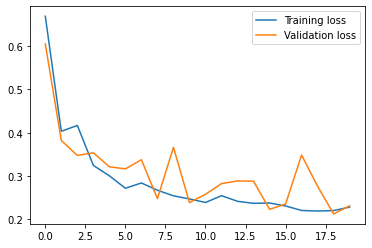

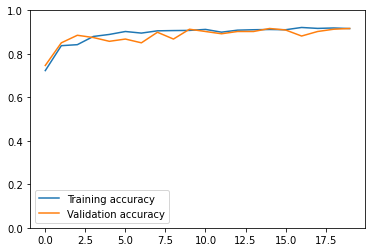

23/23 [==============================] - 0s 1ms/step
La accuracy del modelo es: 0.9111111111111111
La matriz de confusión de las predicciones ha sido: 
 [[228   2   5]
 [  4 219  21]
 [ 19  13 209]]


In [ ]:

inputs = keras.layers.Input(shape=[2048])
layer1 = keras.layers.Dense(units=500, activation="relu")(inputs)
layer2 = keras.layers.Dense(units=200, activation="relu")(layer1)
outputs = keras.layers.Dense(units=3, activation="softmax")(layer2)


dense_model = keras.Model(inputs=inputs, outputs=outputs)
opt = SGD(lr=0.01, decay= 1e-6, momentum=0.9, nesterov=True)
dense_model.compile(optimizer=opt, loss="categorical_crossentropy", metrics=["acc"])


#Lo entrenamos
hist = dense_model.fit(car_train, y_train, batch_size=32, epochs=20, validation_split=0.1)

mostrarEvolucion(hist)

#Clasificamos
y_preds = dense_model.predict(car_test, verbose=True)

print("La accuracy del modelo es: " + str(calcularAccuracy(y_test, y_preds)))

y_test_conf = np.argmax(y_test, axis=1)
y_preds = np.argmax(y_preds, axis=1)
print("La matriz de confusión de las predicciones ha sido: \n", confusion_matrix(y_test_conf, y_preds))

##**VGG19**

In [ ]:
#Definición inicial de nuestro modelo preentrenado en imagenet.
#Para usarlo como extractor de características simple

#Vamos a cargar el modelo antes del ultimo pooling, para usarlo como extractor de caracteristicas
feat_extractor = VGG19(include_top=False, weights='imagenet', pooling='avg', )

#Una vez tenemos el modelo, vamos a compilarlo usando un optimizador y una funcion de perdida
opt = SGD(lr=0.01, decay= 1e-6, momentum=0.9, nesterov=True)

feat_extractor.compile(optimizer=opt, loss="categorical_crossentropy", metrics=["acc"])

#Con esto tenemos el modelo de densenet hasta que nos deja los datos en forma de vector unidimensional
#de dimensión 1024
feat_extractor = keras.Model(inputs=feat_extractor.inputs, outputs= feat_extractor.layers[-1].output)

feat_extractor.compile(optimizer=opt, loss="categorical_crossentropy", metrics=["acc"])

# Extraer las características de las imágenes con el modelo anterior.
car_train = feat_extractor.predict_generator(train_generator.flow(x_train, batch_size=1, shuffle=False),verbose=1, steps=len(x_train))
car_test = feat_extractor.predict_generator(test_generator.flow(x_test, batch_size=1, shuffle=False),verbose=1, steps=len(x_test))

#feat_extractor.summary()

   1/2880 [..............................] - ETA: 7:35

/usr/local/lib/python3.6/dist-packages/tensorflow/python/keras/engine/training.py:1905: UserWarning: `Model.predict_generator` is deprecated and will be removed in a future version. Please use `Model.predict`, which supports generators.
  warnings.warn('`Model.predict_generator` is deprecated and '


720/720 [==============================] - 8s 11ms/step


Epoch 1/20
81/81 [==============================] - 1s 4ms/step - loss: 0.7516 - acc: 0.6922 - val_loss: 0.3179 - val_acc: 0.8924
Epoch 2/20
81/81 [==============================] - 0s 3ms/step - loss: 0.2453 - acc: 0.9084 - val_loss: 0.2262 - val_acc: 0.9271
Epoch 3/20
81/81 [==============================] - 0s 2ms/step - loss: 0.1958 - acc: 0.9334 - val_loss: 0.1647 - val_acc: 0.9514
Epoch 4/20
81/81 [==============================] - 0s 2ms/step - loss: 0.1710 - acc: 0.9384 - val_loss: 0.2094 - val_acc: 0.9201
Epoch 5/20
81/81 [==============================] - 0s 3ms/step - loss: 0.1652 - acc: 0.9329 - val_loss: 0.1650 - val_acc: 0.9479
Epoch 6/20
81/81 [==============================] - 0s 3ms/step - loss: 0.1648 - acc: 0.9387 - val_loss: 0.1493 - val_acc: 0.9479
Epoch 7/20
81/81 [==============================] - 0s 3ms/step - loss: 0.1514 - acc: 0.9472 - val_loss: 0.1391 - val_acc: 0.9618
Epoch 8/20
81/81 [==============================] - 0s 2ms/step - loss: 0.1502 - acc: 0.94

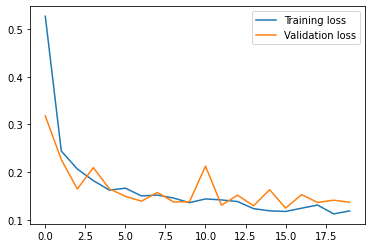

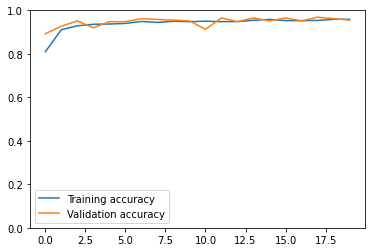

23/23 [==============================] - 0s 1ms/step
La accuracy del modelo es: 0.9069444444444444
La matriz de confusión de las predicciones ha sido: 
 [[231   3   1]
 [  1 240   3]
 [ 13  46 182]]


In [ ]:
inputs = keras.layers.Input(shape=[512])
layer1 = keras.layers.Dense(units=500, activation="relu")(inputs)
layer2 = keras.layers.Dense(units=200, activation="relu")(layer1)
outputs = keras.layers.Dense(units=3, activation="softmax")(layer2)


dense_model = keras.Model(inputs=inputs, outputs=outputs)
opt = SGD(lr=0.01, decay= 1e-6, momentum=0.9, nesterov=True)
dense_model.compile(optimizer=opt, loss="categorical_crossentropy", metrics=["acc"])


#Lo entrenamos
hist = dense_model.fit(car_train, y_train, batch_size=32, epochs=20, validation_split=0.1)

mostrarEvolucion(hist)

#Clasificamos
y_preds = dense_model.predict(car_test, verbose=True)

print("La accuracy del modelo es: " + str(calcularAccuracy(y_test, y_preds)))

y_test_conf = np.argmax(y_test, axis=1)
y_preds = np.argmax(y_preds, axis=1)
print("La matriz de confusión de las predicciones ha sido: \n", confusion_matrix(y_test_conf, y_preds))

##**InceptionV3**

In [ ]:
#Definición inicial de nuestro modelo preentrenado en imagenet.
#Para usarlo como extractor de características simple

#Vamos a cargar el modelo antes del ultimo pooling, para usarlo como extractor de caracteristicas
feat_extractor = InceptionV3(include_top=False, weights='imagenet', pooling='avg', )

#Una vez tenemos el modelo, vamos a compilarlo usando un optimizador y una funcion de perdida
opt = SGD(lr=0.01, decay= 1e-6, momentum=0.9, nesterov=True)

feat_extractor.compile(optimizer=opt, loss="categorical_crossentropy", metrics=["acc"])

#Con esto tenemos el modelo de densenet hasta que nos deja los datos en forma de vector unidimensional
#de dimensión 1024
feat_extractor = keras.Model(inputs=feat_extractor.inputs, outputs= feat_extractor.layers[-1].output)

feat_extractor.compile(optimizer=opt, loss="categorical_crossentropy", metrics=["acc"])

# Extraer las características de las imágenes con el modelo anterior.
car_train = feat_extractor.predict_generator(train_generator.flow(x_train, batch_size=1, shuffle=False),verbose=1, steps=len(x_train))
car_test = feat_extractor.predict_generator(test_generator.flow(x_test, batch_size=1, shuffle=False),verbose=1, steps=len(x_test))

#feat_extractor.summary()

/usr/local/lib/python3.6/dist-packages/tensorflow/python/keras/engine/training.py:1905: UserWarning: `Model.predict_generator` is deprecated and will be removed in a future version. Please use `Model.predict`, which supports generators.
  warnings.warn('`Model.predict_generator` is deprecated and '


720/720 [==============================] - 8s 11ms/step


Epoch 1/20
81/81 [==============================] - 1s 4ms/step - loss: 0.8992 - acc: 0.6174 - val_loss: 0.3390 - val_acc: 0.8854
Epoch 2/20
81/81 [==============================] - 0s 3ms/step - loss: 0.4463 - acc: 0.8424 - val_loss: 0.3286 - val_acc: 0.8854
Epoch 3/20
81/81 [==============================] - 0s 3ms/step - loss: 0.4147 - acc: 0.8507 - val_loss: 0.3260 - val_acc: 0.8715
Epoch 4/20
81/81 [==============================] - 0s 3ms/step - loss: 0.3937 - acc: 0.8595 - val_loss: 0.2850 - val_acc: 0.8819
Epoch 5/20
81/81 [==============================] - 0s 3ms/step - loss: 0.3661 - acc: 0.8635 - val_loss: 0.3008 - val_acc: 0.8819
Epoch 6/20
81/81 [==============================] - 0s 3ms/step - loss: 0.3506 - acc: 0.8825 - val_loss: 0.2742 - val_acc: 0.8993
Epoch 7/20
81/81 [==============================] - 0s 3ms/step - loss: 0.3158 - acc: 0.8827 - val_loss: 0.2540 - val_acc: 0.9028
Epoch 8/20
81/81 [==============================] - 0s 3ms/step - loss: 0.2764 - acc: 0.90

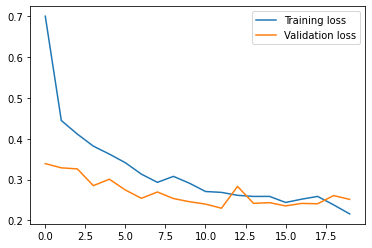

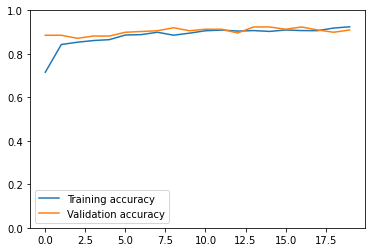

23/23 [==============================] - 0s 1ms/step
La accuracy del modelo es: 0.9152777777777777
La matriz de confusión de las predicciones ha sido: 
 [[233   0   2]
 [ 10 212  22]
 [ 11  16 214]]


In [ ]:
#En este modelo es necesario regularizar
inputs = keras.layers.Input(shape=[2048])
layer1 = keras.layers.Dense(units=500, activation="relu")(inputs)
layer2 = keras.layers.Dropout(0.5)(layer1)
layer3 = keras.layers.Dense(units=200, activation="relu")(layer2)
layer4 = keras.layers.Dropout(0.5)(layer3)
outputs = keras.layers.Dense(units=3, activation="softmax")(layer4)


dense_model = keras.Model(inputs=inputs, outputs=outputs)
opt = SGD(lr=0.01, decay= 1e-6, momentum=0.9, nesterov=True)
dense_model.compile(optimizer=opt, loss="categorical_crossentropy", metrics=["acc"])


#Lo entrenamos
hist = dense_model.fit(car_train, y_train, batch_size=32, epochs=20, validation_split=0.1)

mostrarEvolucion(hist)

#Clasificamos
y_preds = dense_model.predict(car_test, verbose=True)

print("La accuracy del modelo es: " + str(calcularAccuracy(y_test, y_preds)))

y_test_conf = np.argmax(y_test, axis=1)
y_preds = np.argmax(y_preds, axis=1)
print("La matriz de confusión de las predicciones ha sido: \n", confusion_matrix(y_test_conf, y_preds))

#**Xception**

In [ ]:
#Definición inicial de nuestro modelo preentrenado en imagenet.
#Para usarlo como extractor de características simple

#Vamos a cargar el modelo antes del ultimo pooling, para usarlo como extractor de caracteristicas
feat_extractor = Xception(include_top=False, weights='imagenet', pooling='avg', )

#Una vez tenemos el modelo, vamos a compilarlo usando un optimizador y una funcion de perdida
opt = SGD(lr=0.01, decay= 1e-6, momentum=0.9, nesterov=True)

feat_extractor.compile(optimizer=opt, loss="categorical_crossentropy", metrics=["acc"])

#Con esto tenemos el modelo de densenet hasta que nos deja los datos en forma de vector unidimensional
#de dimensión 1024
feat_extractor = keras.Model(inputs=feat_extractor.inputs, outputs= feat_extractor.layers[-1].output)

feat_extractor.compile(optimizer=opt, loss="categorical_crossentropy", metrics=["acc"])

# Extraer las características de las imágenes con el modelo anterior.
car_train = feat_extractor.predict_generator(train_generator.flow(x_train, batch_size=1, shuffle=False),verbose=1, steps=len(x_train))
car_test = feat_extractor.predict_generator(test_generator.flow(x_test, batch_size=1, shuffle=False),verbose=1, steps=len(x_test))

#feat_extractor.summary()

83689472/83683744 [==============================] - 1s 0us/step


/usr/local/lib/python3.6/dist-packages/tensorflow/python/keras/engine/training.py:1905: UserWarning: `Model.predict_generator` is deprecated and will be removed in a future version. Please use `Model.predict`, which supports generators.
  warnings.warn('`Model.predict_generator` is deprecated and '


720/720 [==============================] - 6s 8ms/step


Epoch 1/20
81/81 [==============================] - 1s 7ms/step - loss: 0.7678 - acc: 0.6496 - val_loss: 0.2699 - val_acc: 0.9201
Epoch 2/20
81/81 [==============================] - 0s 3ms/step - loss: 0.3630 - acc: 0.8693 - val_loss: 0.2183 - val_acc: 0.9340
Epoch 3/20
81/81 [==============================] - 0s 3ms/step - loss: 0.3155 - acc: 0.8875 - val_loss: 0.1949 - val_acc: 0.9514
Epoch 4/20
81/81 [==============================] - 0s 3ms/step - loss: 0.2951 - acc: 0.8997 - val_loss: 0.2240 - val_acc: 0.9340
Epoch 5/20
81/81 [==============================] - 0s 3ms/step - loss: 0.2433 - acc: 0.9044 - val_loss: 0.2152 - val_acc: 0.9271
Epoch 6/20
81/81 [==============================] - 0s 3ms/step - loss: 0.2498 - acc: 0.9184 - val_loss: 0.2019 - val_acc: 0.9340
Epoch 7/20
81/81 [==============================] - 0s 3ms/step - loss: 0.2149 - acc: 0.9300 - val_loss: 0.1667 - val_acc: 0.9375
Epoch 8/20
81/81 [==============================] - 0s 3ms/step - loss: 0.2299 - acc: 0.91

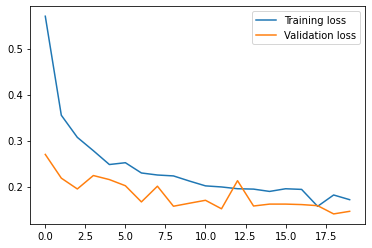

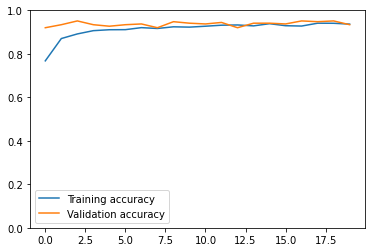

23/23 [==============================] - 0s 1ms/step
La accuracy del modelo es: 0.9319444444444445
La matriz de confusión de las predicciones ha sido: 
 [[233   0   2]
 [  2 226  16]
 [  9  20 212]]


In [ ]:
#En este modelo es necesario regularizar
inputs = keras.layers.Input(shape=[2048])
layer1 = keras.layers.Dense(units=500, activation="relu")(inputs)
layer2 = keras.layers.Dropout(0.5)(layer1)
layer3 = keras.layers.Dense(units=200, activation="relu")(layer2)
layer4 = keras.layers.Dropout(0.5)(layer3)
outputs = keras.layers.Dense(units=3, activation="softmax")(layer4)


dense_model = keras.Model(inputs=inputs, outputs=outputs)
opt = SGD(lr=0.01, decay= 1e-6, momentum=0.9, nesterov=True)
dense_model.compile(optimizer=opt, loss="categorical_crossentropy", metrics=["acc"])


#Lo entrenamos
hist = dense_model.fit(car_train, y_train, batch_size=32, epochs=20, validation_split=0.1)

mostrarEvolucion(hist)

#Clasificamos
y_preds = dense_model.predict(car_test, verbose=True)

print("La accuracy del modelo es: " + str(calcularAccuracy(y_test, y_preds)))

y_test_conf = np.argmax(y_test, axis=1)
y_preds = np.argmax(y_preds, axis=1)
print("La matriz de confusión de las predicciones ha sido: \n", confusion_matrix(y_test_conf, y_preds))